# Blackjack game with SARSA

## Blackjack game

The goal of the game is to beat the dealer by having a hand value of 21 or closest to 21 without going over. Each player is dealt two cards, and then has the option to "hit" and receive additional cards to improve their hand. They can also choose to “stand” and keep the cards they have. If the player exceeds 21, they “bust” and automatically lose the round. If the player has exactly 21, they automatically win. Otherwise, the player wins if they are closer to 21 than the dealer. \
The value of each card is listed below:
- 10/Jack/Queen/King → 10
- 2 through 9 → Same value as card
- Ace → 1 or 11 (Player’s choice)

The game starts with players making their bets, after which the dealer will deal two cards to each player and two to himself, with one card face up and one face down (known as the "hole" card). Players then make their decisions to hit or stand. Once all players have completed their turns, the dealer will reveal their hole card and hit or stand according to a set of rules. If the dealer busts (goes over 21), players who have not bust win. If neither the player nor dealer busts, the hand closest to 21 wins.

## Importing modules

The modules used here are to call the openAI environment, with `gym`, and the basic plotting scheme with `matplotlib` module. `random` is used as the main part regarding the cards dealing and other necessary data management.


In [1]:
import gym
from gym import spaces
import numpy as np
import matplotlib.pyplot as plt
import random
import enum

## Setting up the basics of the game

### Card and deck

The cards' definitions are set up below. 
- `ranks`: a dictionary that maps the string representations of card ranks to their numerical values
- `Suit`: an enumeration of the four suits in a standard deck of playing cards
- `Card`: a class that represents an individual card and contains properties such as the card's suit, rank, and value
- `Deck`: a class that represents a deck of cards and contains methods for shuffling the deck, dealing cards, peeking at the top card, adding cards to the bottom of the deck, and printing the deck

The `Deck` class initializes an empty list of cards when created and populates it with `num` standard decks of playing cards. The `shuffle` method randomly shuffles the cards in the deck. The `deal` method returns the top card of the deck, and the `peek` method returns the top card without removing it from the deck. The `add_to_bottom` method adds a card to the bottom of the deck, and the `__str__` method returns a string representation of the deck. The `__len__` method returns the number of cards in the deck.

In [2]:
ranks = {
    "two" : 2,
    "three" : 3,
    "four" : 4,
    "five" : 5,
    "six" : 6,
    "seven" : 7,
    "eight" : 8,
    "nine" : 9,
    "ten" : 10,
    "jack" : 10,
    "queen" : 10,
    "king" : 10,
    "ace" : (1, 11)
    }

class Suit(enum.Enum):
    spades = "spades"
    clubs = "clubs"
    diamonds = "diamonds"
    hearts = "hearts"
    
class Card:
    def __init__(self, suit, rank, value):
        self.suit = suit
        self.rank = rank
        self.value = value
        
    def __str__(self):
        return self.rank + " of " + self.suit.value
    
class Deck:
    def __init__(self, num=1):
        self.cards = []
        for i in range(num):
            for suit in Suit:
                for rank, value in ranks.items():
                    self.cards.append(Card(suit, rank, value))
                
    def shuffle(self):
        random.shuffle(self.cards)
        
    def deal(self):
        return self.cards.pop(0)
    
    def peek(self):
        if len(self.cards) > 0:
            return self.cards[0]
        
    def add_to_bottom(self, card):
        self.cards.append(card)
        
    def __str__(self):
        result = ""
        for card in self.cards:
            result += str(card) + "\n"
        return result
    
    def __len__(self):
        return len(self.cards)

### Setting up the game's rules

The evaluation of the dealer's hand is done here, following a proper set of rules that are predictable. As the game goes, the dealer will be following *Hard 17* rule. This means the dealer will not hit again if the Ace yields a 17. This also means that Aces initially declared as 11's can be changed to 1's as new cards come.

In [3]:
def dealer_eval(player_hand):
    num_ace = 0
    use_one = 0
    for card in player_hand:
        if card.rank == "ace":
            num_ace += 1
            use_one += card.value[0] # It will be using Ace is equal to 1 in here
        else:
            use_one += card.value
    
    if num_ace > 0:
        ace_counter = 0
        while ace_counter < num_ace:
            use_eleven = use_one + 10 
            
            if use_eleven > 21:
                return use_one
            elif use_eleven >= 17 and use_eleven <= 21:
                return use_eleven
            else:
                use_one = use_eleven
            
            ace_counter += 1
        
        return use_one
    else:
        return use_one

As for the evaluation of the player's hand, it focus on the value of Ace. For instance, if the Ace obtained gets the player to the total sum of 18 to 21, then Ace is equal to 11, otherwise it is equal to 1.

In [4]:
def player_eval(player_hand):
    num_ace = 0
    use_one = 0
    for card in player_hand:
        if card.rank == "ace":
            num_ace += 1
            use_one += card.value[0] # It will be using Ace is equal to 1 in here
        else:
            use_one += card.value
    
    if num_ace > 0:
        ace_counter = 0
        while ace_counter < num_ace:
            use_eleven = use_one + 10 
            
            if use_eleven > 21:
                return use_one
            elif use_eleven >= 18 and use_eleven <= 21:
                return use_eleven
            else:
                use_one = use_eleven
            
            ace_counter += 1
        
        return use_one
    else:
        return use_one

Below, the code for the logic in which the dealer will follow is presented. As the action is rather straightforward, nothing much happens. Following the Hard 17 rule, the dealer will stop hitting after the total is 17 or more.

In [5]:
def dealer_turn(dealer_hand, deck, player_value):
    dealer_value = dealer_eval(dealer_hand)
    while dealer_value < 17 and player_value <= 21:
        dealer_hand.append(deck.deal()) # Making the Hit
        dealer_value = dealer_eval(dealer_hand)

    return dealer_value, dealer_hand, deck

## Setting up the OpenAI environment for Blackjack

The solution is to create a custom class in order to train the bot.

The class has two main attributes:
- the `action_space` attribute, which is a 2-element discrete space representing the two possible actions the player can take: hit (0) or stand (1)
- the `observation_space` attribute, which is a tuple representing the state of the game, consisting of two elements: player hand value (18 possible values ranging from 3 to 20) and the dealer's upcard value (10 possible values ranging from 2 to 11).

The class also implements four main methods:

- `step(action)` method, which takes the player's action as an input, updates the game state, calculates the reward, and returns the new state and the reward.
- `reset()` method, which resets the game to its initial state and returns the start state.
- `_take_action(action)` method, which updates the player's hand according to the player's action.
- `dealer_turn(dealer_hand, bj_deck)` method, which calculates the dealer's final hand value according to the dealer's rules.

The game starts with an initial balance of 1000, and a deck of cards made up of 6 decks. The deck is initialized using the `Deck` class. The game can end in three ways: the player stands, the player's hand value exceeds 21, or the dealer's hand value exceeds 21. The rewards are -1 for losing, 0 for tie, and 1 for winning.

In [6]:
INITIAL_BALANCE = 1000
NUM_DECKS = 6

class BlackjackEnv(gym.Env):
    metadata = {'render.modes': ['human']}
    
    def __init__(self):
        super(BlackjackEnv, self).__init__()
        
        # Initialize the blackjack deck.
        self.bj_deck = Deck(NUM_DECKS)
        
        self.player_hand = []
        self.dealer_hand = []
        
        self.reward_options = {"lose":-1, "tie":0, "win":1}
        
        # hit = 0, stand = 1
        self.action_space = spaces.Discrete(2)
        
        # Second element of the tuple is the range of possible values for the dealer's upcard. (2 through 11)
        self.observation_space = spaces.Tuple((spaces.Discrete(18), spaces.Discrete(10)))
        self.balance = INITIAL_BALANCE
        self.done = False
        self.dealer_value = 0  # Inizializza dealer_value
        
    def _take_action(self, action):
        if action == 0: # hit
            self.player_hand.append(self.bj_deck.deal())
            
        # re-calculate the value of the player's hand after any changes to the hand.
        self.player_value = player_eval(self.player_hand)
    
    def step(self, action):
        self._take_action(action)
        
        # End the episode/game is the player stands or has a hand value >= 21.
        self.done = action == 1 or self.player_value >= 21
        
        # rewards are 0 when the player hits and is still below 21, and they keep playing.
        rewards = 0
        
        if self.done:
            # CALCULATE REWARDS
            if self.player_value > 21: # above 21, player loses automatically.
                rewards = self.reward_options["lose"]
            elif self.player_value == 21: # blackjack! Player wins automatically.
                rewards = self.reward_options["win"]
            else:
                ## Begin dealer turn phase.

                dealer_value, self.dealer_hand, self.bj_deck = dealer_turn(self.dealer_hand, self.bj_deck, self.player_value)
                
                ## End of dealer turn phase

                #------------------------------------------------------------#

                ## Final Compare

                if dealer_value > 21: # dealer above 21, player wins automatically
                    rewards = self.reward_options["win"]
                elif dealer_value == 21: # dealer has blackjack, player loses automatically
                    rewards = self.reward_options["lose"]
                else: # dealer and player have values less than 21.
                    if self.player_value > dealer_value: # player closer to 21, player wins.
                        rewards = self.reward_options["win"]
                    elif self.player_value < dealer_value: # dealer closer to 21, dealer wins.
                        rewards = self.reward_options["lose"]
                    else:
                        rewards = self.reward_options["tie"]
        
        self.balance += rewards
        
        
        # Subtract by 1 to fit into the possible observation range.
        # This makes the possible range of 3 through 20 into 1 through 18
        player_value_obs = self.player_value - 2
        
        # get the value of the dealer's upcard, this value is what the agent sees.
        # Subtract by 1 to fit the possible observation range of 1 to 10.
        upcard_value_obs = dealer_eval([self.dealer_upcard]) - 1
        
        # the state is represented as a player hand-value + dealer upcard pair.
        obs = np.array([player_value_obs, upcard_value_obs])
        
        return obs, rewards, self.done, {}
    
    def reset(self): # resets game to an initial state
        # Add the player and dealer cards back into the deck.
        self.bj_deck.cards += self.player_hand + self.dealer_hand

        # Shuffle before beginning. Only shuffle once before the start of each game.
        self.bj_deck.shuffle()
         
        #self.balance = INITIAL_BALANCE
        
        self.done = False
        
        # returns the start state for the agent
        # deal 2 cards to the agent and the dealer
        self.player_hand = [self.bj_deck.deal(), self.bj_deck.deal()]
        self.dealer_hand = [self.bj_deck.deal(), self.bj_deck.deal()]
        self.dealer_upcard = self.dealer_hand[0]
        
        # calculate the value of the agent's hand
        self.player_value = player_eval(self.player_hand)
        
        # Subtract by 1 to fit into the possible observation range.
        # This makes the possible range of 2 through 20 into 1 through 18
        player_value_obs = self.player_value - 2
            
        # get the value of the dealer's upcard, this value is what the agent sees.
        # Subtract by 1 to fit the possible observation range of 1 to 10.
        upcard_value_obs = dealer_eval([self.dealer_upcard]) - 1
        
        # the state is represented as a player hand-value + dealer upcard pair.
        obs = np.array([player_value_obs, upcard_value_obs])
        
        return obs
    
    def render(self, mode='human', close=False):
        # convert the player hand into a format that is
        # easy to read and understand.
        hand_list = []
        hand_list_dealer = []
        for card in self.player_hand:
            hand_list.append(card.rank)
        

            
        # re-calculate the value of the dealer upcard.
        upcard_value = dealer_eval([self.dealer_upcard])
        
        # Print the dealer_value.
        dealer_value, _, _ = dealer_turn(self.dealer_hand, self.bj_deck, self.player_value)
        
        for card in self.dealer_hand:
            hand_list_dealer.append(card.rank)
            
        print(f'Balance: {self.balance}')
        print(f'Player Hand: {hand_list}')
        print(f'Player Value: {self.player_value}')
        print(f'Dealer Upcard: {upcard_value}')
        print(f'Dealer Hand: {hand_list_dealer}')
        print(f'Dealer Value: {dealer_value}')
        print(f'Done: {self.done}')
        
        print()

After the environment for Blackjack is created, it is necessary to create the Agent, or bot, that will learn how to play the game.

With the learning method of choice defined as the **SARSA**, a class `Agent` represents a reinforcement learning agent that can learn from its environment through trial and error. The agent has various attributes such as the environment it interacts with, its exploration factor `epsilon`, learning rate `alpha`, discount factor `gamma`, and the number of episodes it needs to train on `num_episodes_to_train`. The `Agent` class has several methods that allow it to learn from its interactions with the environment:
- `update_parameters` method: This method updates the exploration factor epsilon and the learning rate alpha after each action the agent takes. The epsilon decreases over time and the agent becomes less explorative as it trains, so that it takes more exploitation-based decisions in the future.

- `create_Q_if_new_observation` method: If the agent encounters a new observation, it sets the initial values of the Q-values for each action to 0.0. The Q-values represent the expected long-term reward of taking a specific action in a specific observation.

- `get_maxQ` method: Given an observation, this method returns the maximum Q-value of all the actions that the agent can take.

- `choose_action` method: Based on the current observation, the agent uses this method to choose an action to take. If a random number is greater than the exploration factor epsilon, the agent chooses the action with the highest Q-value. Otherwise, it takes a random action.

- `learn` method: This method updates the Q-value of the action the agent took based on the reward it received and the utility of the next observation. The new Q-value is computed using a formula that combines the current Q-value with the reward and the discounted utility of the next observation.

In [7]:
class Agent:
    def __init__(self, env, epsilon=1.0, alpha=0.5, gamma=0.8, num_episodes_to_train=100000): #1.0, 0.1, 0.8
        self.env = env
        self.epsilon = epsilon  # Exploration factor
        self.alpha = alpha  # Learning rate
        self.gamma = gamma  # Discount factor
        self.num_episodes_to_train = num_episodes_to_train
        self.Q = {}  # Q-values table

    def update_parameters(self, episode):
        # Decrease exploration factor epsilon over time
        self.epsilon = max(0.1, min(1.0, 1.0 - np.log10((episode + 1) / 25)))
        
        # Update learning rate alpha
        self.alpha = max(0.1, min(1.0, 1.0 - np.log10((episode + 1) / 25)))

    def create_Q_if_new_observation(self, observation):
        if observation not in self.Q:
            self.Q[observation] = [0.0, 0.0]  # Initialize Q-values to 0 for both actions
            
    def get_maxQ(self, observation):
        self.create_Q_if_new_observation(observation)
        return max(self.Q[observation])

    def choose_action(self, observation):
        self.create_Q_if_new_observation(observation)

        if np.random.rand() < self.epsilon:
            return self.env.action_space.sample()  # Exploration: choose a random action
        else:
            maxQ = self.get_maxQ(observation)
            return np.argmax(self.Q[observation])  # Exploitation: choose the action with the highest Q-value

    def learn(self, state, action, reward, next_state, next_action):
        self.create_Q_if_new_observation(next_state)

        # SARSA update rule
        self.Q[state][action] = self.Q[state][action] + self.alpha * (
                reward*2 + self.gamma * self.Q[next_state][next_action] - self.Q[state][action])

    def train(self):
        total_win = 0
        avg_win = 0
        list_avg = []
        count = 0
        self.env.balance = INITIAL_BALANCE
        
        for episode in range(self.num_episodes_to_train):
            state = self.env.reset()
            state = tuple(state)

            action = self.choose_action(state)

            total_reward = 0
            count += 1
            
            while True:
                next_state, reward, done, _ = self.env.step(action)
                next_state = tuple(next_state)
                next_action = self.choose_action(next_state)
                
                total_reward += reward
                
                if reward == 1:
                    total_win += reward
                
                # Learn from the experience
                self.learn(state, action, reward, next_state, next_action)

                state = next_state
                action = next_action
            
                if done:
                    break
            # Update exploration and learning rates
            self.update_parameters(episode)
            
            #if episode % 10 == 0:
                
                # Calculate the winning average
                #avg_win = total_win / self.num_episodes_to_train
                #print(f"Episode: {episode}, Win Rate: {avg_win * 100}")
            
            #print(f"Episode: {episode}, Win Rate: {avg_win * 100}")
            #avg_win = total_win / 100
            #list_avg.append(avg_win)
            #total_win = 0
            env.render()
            # Print episode information
            if episode % 100 == 0 and not episode == 1:
                avg_win = total_win / count
                list_avg.append(avg_win)

        #print(f"Episode: {episode}, Win Rate: {avg_win * 100}")      
        plt.plot(list_avg)
        plt.xlabel('Episodes')
        plt.ylabel('Win rate')
        plt.show()
            

    def test(self, num_episodes=10):
        total_rewards = 0
        total_win = 0
        i = 0
        
        for i in range(num_episodes):
            state = self.env.reset()
            state = tuple(state)
            action = self.choose_action(state)
            
            while True:
                next_state, reward, done, _ = self.env.step(action)
                next_state = tuple(next_state)
                action = self.choose_action(next_state)

                total_rewards += reward
                if reward == 1:
                    total_win += reward
                    
                if done:
                    break
            
        average_reward = total_rewards / num_episodes
        avg_win = total_win / num_episodes
        print(f"Average Reward over {num_episodes} episodes: {avg_win * 100}")

In [8]:
#print(f"WE: {sarsa_agent.Q}")

In [9]:
# Create Blackjack environment
env = BlackjackEnv()

In [10]:
# Create SARSA agent
sarsa_agent = Agent(env)

Balance: 999
Player Hand: ['eight', 'four']
Player Value: 12
Dealer Upcard: 2
Dealer Hand: ['two', 'six', 'six', 'six']
Dealer Value: 20
Done: True

Balance: 998
Player Hand: ['ten', 'two', 'three']
Player Value: 15
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: 999
Player Hand: ['ace', 'ace', 'eight']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'king']
Dealer Value: 19
Done: True

Balance: 998
Player Hand: ['six', 'king']
Player Value: 16
Dealer Upcard: 7
Dealer Hand: ['seven', 'six', 'two', 'two']
Dealer Value: 17
Done: True

Balance: 997
Player Hand: ['two', 'jack', 'four']
Player Value: 16
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'two', 'five']
Dealer Value: 20
Done: True

Balance: 996
Player Hand: ['two', 'four', 'four', 'six']
Player Value: 16
Dealer Upcard: 10
Dealer Hand: ['jack', 'king']
Dealer Value: 20
Done: True

Balance: 996
Player Hand: ['king', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen

Balance: 875
Player Hand: ['six', 'ace']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'king']
Dealer Value: 17
Done: True

Balance: 874
Player Hand: ['seven', 'eight']
Player Value: 15
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'seven', 'five']
Dealer Value: 20
Done: True

Balance: 875
Player Hand: ['eight', 'eight', 'five']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: 874
Player Hand: ['ace', 'ace', 'king']
Player Value: 12
Dealer Upcard: 10
Dealer Hand: ['king', 'eight']
Dealer Value: 18
Done: True

Balance: 875
Player Hand: ['nine', 'six']
Player Value: 15
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'eight']
Dealer Value: 24
Done: True

Balance: 876
Player Hand: ['nine', 'six', 'five']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: 877
Player Hand: ['five', 'nine', 'five']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'four', 'ni

Balance: 805
Player Hand: ['ace', 'ten', 'four']
Player Value: 15
Dealer Upcard: 2
Dealer Hand: ['two', 'two', 'four', 'jack']
Dealer Value: 18
Done: True

Balance: 804
Player Hand: ['two', 'ten', 'ace', 'jack']
Player Value: 23
Dealer Upcard: 9
Dealer Hand: ['nine', 'three']
Dealer Value: 12
Done: True

Balance: 805
Player Hand: ['nine', 'two', 'nine']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'three', 'eight', 'ten']
Dealer Value: 24
Done: True

Balance: 804
Player Hand: ['three', 'king']
Player Value: 13
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'ten']
Dealer Value: 19
Done: True

Balance: 805
Player Hand: ['three', 'queen']
Player Value: 13
Dealer Upcard: 6
Dealer Hand: ['six', 'seven', 'ten']
Dealer Value: 23
Done: True

Balance: 804
Player Hand: ['jack', 'five', 'ace', 'six']
Player Value: 22
Dealer Upcard: 7
Dealer Hand: ['seven', 'three']
Dealer Value: 10
Done: True

Balance: 803
Player Hand: ['ace', 'three', 'nine', 'ace', 'jack']
Player Value: 24
Dealer Up

Balance: 719
Player Hand: ['nine', 'king']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'two', 'ace', 'seven', 'nine']
Dealer Value: 21
Done: True

Balance: 719
Player Hand: ['two', 'jack', 'eight']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'six', 'four']
Dealer Value: 20
Done: True

Balance: 720
Player Hand: ['four', 'queen']
Player Value: 14
Dealer Upcard: 6
Dealer Hand: ['six', 'king', 'nine']
Dealer Value: 25
Done: True

Balance: 721
Player Hand: ['eight', 'three', 'ten']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: 720
Player Hand: ['three', 'queen', 'four', 'seven']
Player Value: 24
Dealer Upcard: 3
Dealer Hand: ['three', 'two']
Dealer Value: 5
Done: True

Balance: 719
Player Hand: ['seven', 'ten', 'eight']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: 718
Player Hand: ['ten', 'three', 'three', 'nine']
Player Value: 25
Dealer Upcard: 10
Deale

Balance: 648
Player Hand: ['king', 'queen']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'three', 'eight', 'ten']
Dealer Value: 26
Done: True

Balance: 649
Player Hand: ['seven', 'five', 'four', 'five']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'three', 'nine']
Dealer Value: 19
Done: True

Balance: 650
Player Hand: ['four', 'two', 'three', 'queen']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'eight', 'four', 'jack']
Dealer Value: 24
Done: True

Balance: 651
Player Hand: ['eight', 'ace', 'five', 'seven']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'queen']
Dealer Value: 20
Done: True

Balance: 652
Player Hand: ['ten', 'two', 'two']
Player Value: 14
Dealer Upcard: 4
Dealer Hand: ['four', 'jack', 'queen']
Dealer Value: 24
Done: True

Balance: 651
Player Hand: ['three', 'five', 'five', 'six', 'nine']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: 650
Player Hand: ['two', 'queen', 'thr

Balance: 572
Player Hand: ['king', 'two', 'three']
Player Value: 15
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'eight', 'king']
Dealer Value: 26
Done: True

Balance: 571
Player Hand: ['nine', 'eight', 'queen']
Player Value: 27
Dealer Upcard: 9
Dealer Hand: ['nine', 'five']
Dealer Value: 14
Done: True

Balance: 571
Player Hand: ['six', 'ace', 'seven', 'six']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: 572
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'queen']
Dealer Value: 26
Done: True

Balance: 571
Player Hand: ['queen', 'eight']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['king', 'five', 'four']
Dealer Value: 19
Done: True

Balance: 572
Player Hand: ['nine', 'queen']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'four', 'four', 'ace', 'king']
Dealer Value: 22
Done: True

Balance: 571
Player Hand: ['four', 'nine', 'ace']
Player Value: 14
Dealer Upcard: 6
Dealer 

Balance: 456
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: 455
Player Hand: ['eight', 'jack']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'five', 'jack']
Dealer Value: 21
Done: True

Balance: 456
Player Hand: ['four', 'seven', 'king']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: 457
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: 457
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'four', 'seven', 'four']
Dealer Value: 18
Done: True

Balance: 456
Player Hand: ['six', 'ten', 'ace']
Player Value: 17
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'seven']
Dealer Value: 18
Done: True

Balance: 455
Player Hand: ['four', 'king', 'five', 'six']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['king', 'ace']
Dealer Value: 

Balance: 401
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: 400
Player Hand: ['four', 'king']
Player Value: 14
Dealer Upcard: 6
Dealer Hand: ['six', 'ten', 'ace']
Dealer Value: 17
Done: True

Balance: 399
Player Hand: ['two', 'ace', 'king', 'king']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: 399
Player Hand: ['five', 'nine', 'three']
Player Value: 17
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: 398
Player Hand: ['six', 'four', 'nine']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: 397
Player Hand: ['queen', 'six', 'king']
Player Value: 26
Dealer Upcard: 7
Dealer Hand: ['seven', 'five']
Dealer Value: 12
Done: True

Balance: 396
Player Hand: ['king', 'four', 'six', 'five']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'king']
Dealer Value

Balance: 290
Player Hand: ['seven', 'king']
Player Value: 17
Dealer Upcard: 5
Dealer Hand: ['five', 'five', 'six', 'four']
Dealer Value: 20
Done: True

Balance: 289
Player Hand: ['seven', 'six', 'six']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: 288
Player Hand: ['queen', 'seven', 'three', 'jack']
Player Value: 30
Dealer Upcard: 8
Dealer Hand: ['eight', 'five']
Dealer Value: 13
Done: True

Balance: 287
Player Hand: ['nine', 'jack', 'three']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: 288
Player Hand: ['four', 'three', 'three']
Player Value: 10
Dealer Upcard: 6
Dealer Hand: ['six', 'six', 'jack']
Dealer Value: 22
Done: True

Balance: 289
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'jack']
Dealer Value: 22
Done: True

Balance: 290
Player Hand: ['three', 'seven', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack'

Balance: 203
Player Hand: ['seven', 'queen', 'five']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'five']
Dealer Value: 13
Done: True

Balance: 202
Player Hand: ['two', 'six', 'ten', 'nine']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['queen', 'three']
Dealer Value: 13
Done: True

Balance: 203
Player Hand: ['two', 'jack', 'nine']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'four', 'nine', 'seven']
Dealer Value: 21
Done: True

Balance: 204
Player Hand: ['ten', 'queen']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'eight', 'six', 'ten']
Dealer Value: 26
Done: True

Balance: 205
Player Hand: ['king', 'queen']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: 206
Player Hand: ['nine', 'two', 'eight']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: 205
Player Hand: ['ten', 'five', 'nine']
Player Value: 24
Dealer Upcard: 6
Dealer Hand: ['six', 'th

Balance: 124
Player Hand: ['ten', 'queen']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'seven']
Dealer Value: 17
Done: True

Balance: 125
Player Hand: ['seven', 'four', 'two', 'seven']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'queen', 'six']
Dealer Value: 19
Done: True

Balance: 126
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'seven']
Dealer Value: 17
Done: True

Balance: 127
Player Hand: ['seven', 'five']
Player Value: 12
Dealer Upcard: 6
Dealer Hand: ['six', 'nine', 'eight']
Dealer Value: 23
Done: True

Balance: 126
Player Hand: ['seven', 'king', 'ace']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'queen', 'seven']
Dealer Value: 21
Done: True

Balance: 125
Player Hand: ['nine', 'eight', 'six']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: 124
Player Hand: ['ten', 'seven', 'king']
Player Value: 27
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
De

Balance: 96
Player Hand: ['four', 'nine', 'eight']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'six', 'ten']
Dealer Value: 26
Done: True

Balance: 97
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'six']
Dealer Value: 17
Done: True

Balance: 98
Player Hand: ['six', 'five', 'two', 'six']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'three', 'eight']
Dealer Value: 22
Done: True

Balance: 99
Player Hand: ['ace', 'ten']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'eight']
Dealer Value: 18
Done: True

Balance: 100
Player Hand: ['three', 'four', 'seven', 'five']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'two', 'jack', 'jack']
Dealer Value: 25
Done: True

Balance: 101
Player Hand: ['jack', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'five', 'five']
Dealer Value: 20
Done: True

Balance: 100
Player Hand: ['nine', 'two', 'three', 'two', 'three']
Player Value: 19
Dealer Upcard: 

Balance: 13
Player Hand: ['four', 'ten', 'king']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: 12
Player Hand: ['two', 'nine', 'six']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'six', 'five']
Dealer Value: 18
Done: True

Balance: 13
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'four', 'five', 'seven']
Dealer Value: 19
Done: True

Balance: 13
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: 14
Player Hand: ['ten', 'five', 'three']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'jack', 'three']
Dealer Value: 17
Done: True

Balance: 15
Player Hand: ['seven', 'four', 'queen']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'eight', 'seven']
Dealer Value: 20
Done: True

Balance: 14
Player Hand: ['three', 'jack', 'queen']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['thre

Balance: -22
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'six', 'jack']
Dealer Value: 22
Done: True

Balance: -23
Player Hand: ['four', 'two']
Player Value: 6
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -22
Player Hand: ['jack', 'eight']
Player Value: 18
Dealer Upcard: 9
Dealer Hand: ['nine', 'three', 'two', 'eight']
Dealer Value: 22
Done: True

Balance: -21
Player Hand: ['four', 'ace', 'six']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'four', 'ten']
Dealer Value: 22
Done: True

Balance: -22
Player Hand: ['eight', 'three', 'ace', 'queen']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -21
Player Hand: ['five', 'nine', 'four']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'four', 'five', 'king']
Dealer Value: 25
Done: True

Balance: -22
Player Hand: ['jack', 'ace', 'six', 'seven']
Player Value: 24
Dealer Upcard: 5
Dealer Hand: ['fi

Balance: -110
Player Hand: ['five', 'six', 'four', 'ace', 'two']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'ace']
Dealer Value: 19
Done: True

Balance: -111
Player Hand: ['ten', 'three', 'nine']
Player Value: 22
Dealer Upcard: 3
Dealer Hand: ['three', 'king']
Dealer Value: 13
Done: True

Balance: -112
Player Hand: ['queen', 'six', 'two']
Player Value: 18
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -113
Player Hand: ['nine', 'two', 'two', 'two', 'two', 'king']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: -114
Player Hand: ['six', 'queen', 'king']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['ten', 'three']
Dealer Value: 13
Done: True

Balance: -113
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'six', 'nine']
Dealer Value: 17
Done: True

Balance: -114
Player Hand: ['three', 'six']
Player Value: 9
Dealer Upcard: 2
Dealer Hand: ['two',

Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'six', 'seven']
Dealer Value: 17
Done: True

Balance: -184
Player Hand: ['eight', 'five', 'queen']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'five']
Dealer Value: 13
Done: True

Balance: -185
Player Hand: ['four', 'eight', 'queen']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'two']
Dealer Value: 11
Done: True

Balance: -186
Player Hand: ['queen', 'four', 'nine']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'eight']
Dealer Value: 10
Done: True

Balance: -187
Player Hand: ['six', 'six']
Player Value: 12
Dealer Upcard: 6
Dealer Hand: ['six', 'two', 'queen']
Dealer Value: 18
Done: True

Balance: -186
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -185
Player Hand: ['eight', 'king', 'three']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -186
Player Hand: ['queen

Balance: -281
Player Hand: ['ten', 'six', 'king']
Player Value: 26
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -282
Player Hand: ['six', 'jack', 'four']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'ace']
Dealer Value: 21
Done: True

Balance: -282
Player Hand: ['nine', 'jack']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'six', 'four']
Dealer Value: 19
Done: True

Balance: -281
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'ace']
Dealer Value: 19
Done: True

Balance: -280
Player Hand: ['three', 'six']
Player Value: 9
Dealer Upcard: 9
Dealer Hand: ['nine', 'four', 'nine']
Dealer Value: 22
Done: True

Balance: -279
Player Hand: ['king', 'six', 'ace', 'four']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'nine', 'eight']
Dealer Value: 22
Done: True

Balance: -280
Player Hand: ['eight', 'eight', 'jack']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['jack', 'four']
Dealer Val

Balance: -376
Player Hand: ['queen', 'six']
Player Value: 16
Dealer Upcard: 4
Dealer Hand: ['four', 'jack', 'king']
Dealer Value: 24
Done: True

Balance: -377
Player Hand: ['two', 'three']
Player Value: 5
Dealer Upcard: 5
Dealer Hand: ['five', 'four', 'eight']
Dealer Value: 17
Done: True

Balance: -376
Player Hand: ['five', 'king', 'three']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'two', 'seven']
Dealer Value: 17
Done: True

Balance: -375
Player Hand: ['nine', 'king']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'eight', 'ace']
Dealer Value: 17
Done: True

Balance: -376
Player Hand: ['three', 'three']
Player Value: 6
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -376
Player Hand: ['four', 'six', 'eight', 'two']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -375
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dea

Balance: -435
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'five', 'five']
Dealer Value: 18
Done: True

Balance: -435
Player Hand: ['eight', 'five', 'two', 'four']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'jack', 'seven']
Dealer Value: 19
Done: True

Balance: -436
Player Hand: ['five', 'five', 'ten', 'king']
Player Value: 30
Dealer Upcard: 4
Dealer Hand: ['four', 'five']
Dealer Value: 9
Done: True

Balance: -437
Player Hand: ['seven', 'ace']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'three', 'ten', 'four']
Dealer Value: 20
Done: True

Balance: -438
Player Hand: ['jack', 'eight', 'nine']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -439
Player Hand: ['eight', 'eight', 'jack']
Player Value: 26
Dealer Upcard: 7
Dealer Hand: ['seven', 'two']
Dealer Value: 9
Done: True

Balance: -440
Player Hand: ['six', 'king', 'queen']
Player Value: 26
Dealer Upcard: 8
Dealer H

Balance: -578
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'ten', 'five']
Dealer Value: 20
Done: True

Balance: -577
Player Hand: ['three', 'eight', 'queen']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -578
Player Hand: ['four', 'seven', 'ace', 'eight', 'six']
Player Value: 26
Dealer Upcard: 9
Dealer Hand: ['nine', 'three']
Dealer Value: 12
Done: True

Balance: -579
Player Hand: ['seven', 'king', 'ace', 'jack']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['ten', 'three']
Dealer Value: 13
Done: True

Balance: -578
Player Hand: ['jack', 'five', 'six']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'ten', 'six']
Dealer Value: 21
Done: True

Balance: -577
Player Hand: ['four', 'seven', 'king']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -578
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['tw

Balance: -680
Player Hand: ['four', 'ace', 'nine', 'four']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -681
Player Hand: ['five', 'ten', 'four']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'ten']
Dealer Value: 21
Done: True

Balance: -682
Player Hand: ['ten', 'six', 'nine']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'five']
Dealer Value: 15
Done: True

Balance: -683
Player Hand: ['nine', 'two', 'seven']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'queen']
Dealer Value: 20
Done: True

Balance: -684
Player Hand: ['queen', 'ace', 'four', 'ace']
Player Value: 16
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'ace']
Dealer Value: 18
Done: True

Balance: -683
Player Hand: ['eight', 'two', 'six']
Player Value: 16
Dealer Upcard: 2
Dealer Hand: ['two', 'jack', 'ace', 'two', 'eight']
Dealer Value: 23
Done: True

Balance: -684
Player Hand: ['ace', 'queen', 'five', 'queen']
Player Value: 26


Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'queen', 'seven']
Dealer Value: 23
Done: True

Balance: -751
Player Hand: ['two', 'five', 'two', 'nine']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'six', 'nine']
Dealer Value: 23
Done: True

Balance: -751
Player Hand: ['king', 'nine']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -750
Player Hand: ['jack', 'six', 'ace']
Player Value: 17
Dealer Upcard: 5
Dealer Hand: ['five', 'eight', 'three', 'nine']
Dealer Value: 25
Done: True

Balance: -751
Player Hand: ['three', 'ten', 'nine']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'seven']
Dealer Value: 15
Done: True

Balance: -752
Player Hand: ['three', 'six', 'eight', 'eight']
Player Value: 25
Dealer Upcard: 6
Dealer Hand: ['six', 'three']
Dealer Value: 9
Done: True

Balance: -753
Player Hand: ['two', 'nine', 'three', 'three', 'jack']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['queen', 'two']
Dealer

Balance: -857
Player Hand: ['five', 'three', 'ten']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'three', 'three', 'king']
Dealer Value: 21
Done: True

Balance: -858
Player Hand: ['five', 'queen', 'ace', 'six']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'four']
Dealer Value: 15
Done: True

Balance: -859
Player Hand: ['four', 'ten', 'queen']
Player Value: 24
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -858
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'ace', 'ace', 'nine', 'ace', 'eight']
Dealer Value: 23
Done: True

Balance: -859
Player Hand: ['five', 'jack', 'seven']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['king', 'two']
Dealer Value: 12
Done: True

Balance: -860
Player Hand: ['ten', 'king', 'two']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'nine']
Dealer Value: 11
Done: True

Balance: -861
Player Hand: ['eight', 'two', 'four', 'queen']
Player Value: 24
Dealer

Balance: -917
Player Hand: ['seven', 'queen', 'six']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'king']
Dealer Value: 20
Done: True

Balance: -918
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'ten', 'six']
Dealer Value: 20
Done: True

Balance: -919
Player Hand: ['seven', 'king', 'nine']
Player Value: 26
Dealer Upcard: 9
Dealer Hand: ['nine', 'four']
Dealer Value: 13
Done: True

Balance: -920
Player Hand: ['four', 'queen', 'ace', 'king']
Player Value: 25
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -921
Player Hand: ['nine', 'eight', 'ten']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -920
Player Hand: ['ace', 'ten']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -921
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'ace']
Dealer Value: 21
Done: 

Balance: -1021
Player Hand: ['ace', 'four', 'seven', 'eight']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -1022
Player Hand: ['seven', 'seven', 'ten']
Player Value: 24
Dealer Upcard: 3
Dealer Hand: ['three', 'five']
Dealer Value: 8
Done: True

Balance: -1023
Player Hand: ['two', 'five', 'jack', 'nine']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -1022
Player Hand: ['ace', 'queen', 'eight']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'king', 'two', 'eight']
Dealer Value: 24
Done: True

Balance: -1023
Player Hand: ['six', 'seven', 'three', 'nine']
Player Value: 25
Dealer Upcard: 2
Dealer Hand: ['two', 'seven']
Dealer Value: 9
Done: True

Balance: -1024
Player Hand: ['nine', 'four', 'king']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'four']
Dealer Value: 14
Done: True

Balance: -1025
Player Hand: ['two', 'three', 'king', 'jack']
Player Value: 25


Balance: -1091
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'nine', 'two', 'jack']
Dealer Value: 23
Done: True

Balance: -1092
Player Hand: ['six', 'nine', 'ten']
Player Value: 25
Dealer Upcard: 8
Dealer Hand: ['eight', 'five']
Dealer Value: 13
Done: True

Balance: -1093
Player Hand: ['seven', 'ten', 'jack']
Player Value: 27
Dealer Upcard: 2
Dealer Hand: ['two', 'queen']
Dealer Value: 12
Done: True

Balance: -1094
Player Hand: ['ten', 'four', 'queen']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['king', 'four']
Dealer Value: 14
Done: True

Balance: -1093
Player Hand: ['five', 'jack', 'two', 'two']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'three', 'jack']
Dealer Value: 17
Done: True

Balance: -1094
Player Hand: ['two', 'queen', 'two', 'queen']
Player Value: 24
Dealer Upcard: 6
Dealer Hand: ['six', 'four']
Dealer Value: 10
Done: True

Balance: -1095
Player Hand: ['eight', 'jack', 'five']
Player Value: 23
Dealer Upcard: 10
Dealer 

Dealer Hand: ['king', 'ten']
Dealer Value: 20
Done: True

Balance: -1188
Player Hand: ['three', 'eight', 'jack']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'three', 'ten']
Dealer Value: 23
Done: True

Balance: -1189
Player Hand: ['four', 'ace', 'ten', 'ten']
Player Value: 25
Dealer Upcard: 3
Dealer Hand: ['three', 'nine']
Dealer Value: 12
Done: True

Balance: -1190
Player Hand: ['two', 'eight', 'two', 'ace', 'two', 'ace', 'king']
Player Value: 26
Dealer Upcard: 5
Dealer Hand: ['five', 'four']
Dealer Value: 9
Done: True

Balance: -1189
Player Hand: ['four', 'eight', 'seven']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'nine', 'five']
Dealer Value: 18
Done: True

Balance: -1190
Player Hand: ['four', 'king', 'jack']
Player Value: 24
Dealer Upcard: 4
Dealer Hand: ['four', 'two']
Dealer Value: 6
Done: True

Balance: -1191
Player Hand: ['king', 'two', 'five', 'eight']
Player Value: 25
Dealer Upcard: 3
Dealer Hand: ['three', 'queen']
Dealer Value: 13
Done: True

Bala

Balance: -1301
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight', 'two']
Dealer Value: 18
Done: True

Balance: -1300
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'six', 'eight']
Dealer Value: 18
Done: True

Balance: -1299
Player Hand: ['king', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'three']
Dealer Value: 19
Done: True

Balance: -1298
Player Hand: ['king', 'seven', 'four']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'four', 'three']
Dealer Value: 17
Done: True

Balance: -1297
Player Hand: ['six', 'five', 'ten']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'seven']
Dealer Value: 17
Done: True

Balance: -1296
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dealer Value: 20
Done: True

Balance: -1295
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 

Balance: -1410
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'four', 'two', 'nine']
Dealer Value: 17
Done: True

Balance: -1411
Player Hand: ['four', 'six', 'jack']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'seven', 'eight']
Dealer Value: 21
Done: True

Balance: -1410
Player Hand: ['jack', 'six', 'four']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: -1409
Player Hand: ['four', 'eight', 'nine']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'queen']
Dealer Value: 19
Done: True

Balance: -1410
Player Hand: ['seven', 'king', 'eight']
Player Value: 25
Dealer Upcard: 7
Dealer Hand: ['seven', 'four']
Dealer Value: 11
Done: True

Balance: -1410
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'queen']
Dealer Value: 20
Done: True

Balance: -1411
Player Hand: ['nine', 'six', 'jack']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'j

Balance: -1513
Player Hand: ['three', 'three', 'seven', 'ten']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'five']
Dealer Value: 7
Done: True

Balance: -1514
Player Hand: ['five', 'seven']
Player Value: 12
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'ace']
Dealer Value: 17
Done: True

Balance: -1514
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -1515
Player Hand: ['queen', 'two', 'seven']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'four', 'jack']
Dealer Value: 20
Done: True

Balance: -1514
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'nine']
Dealer Value: 19
Done: True

Balance: -1515
Player Hand: ['eight', 'two', 'six', 'two', 'king']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['ten', 'four']
Dealer Value: 14
Done: True

Balance: -1516
Player Hand: ['three', 'nine', 'ace', 'jack']
Player Value: 23
Dealer Upcard: 9
Dealer Hand: [

Balance: -1616
Player Hand: ['two', 'ten', 'jack']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -1617
Player Hand: ['three', 'three', 'king', 'seven']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -1616
Player Hand: ['three', 'five']
Player Value: 8
Dealer Upcard: 6
Dealer Hand: ['six', 'ten', 'queen']
Dealer Value: 26
Done: True

Balance: -1617
Player Hand: ['four', 'nine', 'ten']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -1618
Player Hand: ['king', 'six', 'king']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: -1619
Player Hand: ['ace', 'two', 'king', 'four', 'seven']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'three']
Dealer Value: 14
Done: True

Balance: -1620
Player Hand: ['ace', 'two', 'five', 'queen', 'ace', 'ace']
Player Value: 20
Dealer 

Balance: -1691
Player Hand: ['five', 'four', 'nine', 'king']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -1690
Player Hand: ['seven', 'king', 'ace']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'three', 'ten', 'six']
Dealer Value: 22
Done: True

Balance: -1691
Player Hand: ['two', 'seven', 'six', 'nine']
Player Value: 24
Dealer Upcard: 3
Dealer Hand: ['three', 'eight']
Dealer Value: 11
Done: True

Balance: -1692
Player Hand: ['two', 'four', 'three', 'five', 'eight']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'four']
Dealer Value: 9
Done: True

Balance: -1691
Player Hand: ['ace', 'three', 'seven']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'four', 'two']
Dealer Value: 17
Done: True

Balance: -1690
Player Hand: ['queen', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'four', 'jack']
Dealer Value: 24
Done: True

Balance: -1689
Player Hand: ['six', 'nine', 'five']
Player Value

Balance: -1798
Player Hand: ['three', 'five', 'nine', 'two', 'jack']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -1797
Player Hand: ['king', 'queen']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'five', 'six', 'three']
Dealer Value: 19
Done: True

Balance: -1798
Player Hand: ['five', 'seven', 'five']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['king', 'ten']
Dealer Value: 20
Done: True

Balance: -1799
Player Hand: ['queen', 'ace', 'two', 'two', 'king']
Player Value: 25
Dealer Upcard: 4
Dealer Hand: ['four', 'nine']
Dealer Value: 13
Done: True

Balance: -1800
Player Hand: ['five', 'king', 'jack']
Player Value: 25
Dealer Upcard: 6
Dealer Hand: ['six', 'five']
Dealer Value: 11
Done: True

Balance: -1801
Player Hand: ['nine', 'four', 'ace', 'nine']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'four']
Dealer Value: 14
Done: True

Balance: -1800
Player Hand: ['jack', 'eight']
Player Value: 18
Dealer Upcard

Balance: -1898
Player Hand: ['eight', 'three', 'eight']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'two', 'seven']
Dealer Value: 18
Done: True

Balance: -1897
Player Hand: ['king', 'ten']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'three', 'queen', 'eight']
Dealer Value: 22
Done: True

Balance: -1896
Player Hand: ['eight', 'jack']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'seven', 'five']
Dealer Value: 17
Done: True

Balance: -1897
Player Hand: ['ace', 'seven', 'five', 'four']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['jack', 'ace']
Dealer Value: 21
Done: True

Balance: -1897
Player Hand: ['six', 'three', 'two', 'nine']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'six', 'four']
Dealer Value: 20
Done: True

Balance: -1898
Player Hand: ['four', 'ten', 'five']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'two', 'queen']
Dealer Value: 21
Done: True

Balance: -1899
Player Hand: ['king', 'king', 'two']
Player Value: 22
De

Balance: -1976
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'queen']
Dealer Value: 18
Done: True

Balance: -1975
Player Hand: ['three', 'six', 'queen']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'queen', 'four']
Dealer Value: 17
Done: True

Balance: -1976
Player Hand: ['two', 'three', 'nine', 'king']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -1975
Player Hand: ['four', 'king', 'seven']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'jack', 'ten']
Dealer Value: 25
Done: True

Balance: -1976
Player Hand: ['seven', 'nine', 'seven']
Player Value: 23
Dealer Upcard: 4
Dealer Hand: ['four', 'two']
Dealer Value: 6
Done: True

Balance: -1976
Player Hand: ['eight', 'ten', 'two']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'four', 'six']
Dealer Value: 20
Done: True

Balance: -1977
Player Hand: ['five', 'ten', 'ace', 'king']
Player Value: 26
Deale

Balance: -2125
Player Hand: ['three', 'seven', 'seven']
Player Value: 17
Dealer Upcard: 6
Dealer Hand: ['six', 'jack', 'jack']
Dealer Value: 26
Done: True

Balance: -2126
Player Hand: ['six', 'seven', 'three', 'queen']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['ten', 'two']
Dealer Value: 12
Done: True

Balance: -2127
Player Hand: ['eight', 'queen', 'five']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: -2126
Player Hand: ['four', 'ten', 'seven']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'king']
Dealer Value: 21
Done: True

Balance: -2125
Player Hand: ['seven', 'ten', 'three']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'four', 'three']
Dealer Value: 17
Done: True

Balance: -2124
Player Hand: ['two', 'nine', 'four']
Player Value: 15
Dealer Upcard: 6
Dealer Hand: ['six', 'nine', 'seven']
Dealer Value: 22
Done: True

Balance: -2125
Player Hand: ['four', 'two', 'ten']
Player Value: 16
Dealer Up

Balance: -2193
Player Hand: ['three', 'nine', 'queen']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['queen', 'two']
Dealer Value: 12
Done: True

Balance: -2194
Player Hand: ['five', 'two', 'three', 'nine']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'nine', 'seven']
Dealer Value: 20
Done: True

Balance: -2193
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'six', 'queen']
Dealer Value: 25
Done: True

Balance: -2193
Player Hand: ['four', 'king', 'six']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -2192
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -2193
Player Hand: ['nine', 'king', 'ten']
Player Value: 29
Dealer Upcard: 10
Dealer Hand: ['queen', 'five']
Dealer Value: 15
Done: True

Balance: -2194
Player Hand: ['five', 'nine', 'jack']
Player Value: 24
Dealer Upcard: 8
Dealer Hand: ['ei

Balance: -2309
Player Hand: ['queen', 'king']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'four', 'two']
Dealer Value: 17
Done: True

Balance: -2308
Player Hand: ['queen', 'king']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'five', 'jack']
Dealer Value: 24
Done: True

Balance: -2307
Player Hand: ['ace', 'jack', 'king']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'jack', 'nine']
Dealer Value: 24
Done: True

Balance: -2308
Player Hand: ['four', 'king', 'five']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'seven', 'five', 'ace', 'five']
Dealer Value: 20
Done: True

Balance: -2309
Player Hand: ['three', 'seven', 'five', 'king']
Player Value: 25
Dealer Upcard: 2
Dealer Hand: ['two', 'queen']
Dealer Value: 12
Done: True

Balance: -2308
Player Hand: ['four', 'seven', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'five', 'two']
Dealer Value: 17
Done: True

Balance: -2309
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcar

Balance: -2401
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'queen', 'three']
Dealer Value: 19
Done: True

Balance: -2402
Player Hand: ['three', 'five', 'nine', 'two']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'ten']
Dealer Value: 20
Done: True

Balance: -2401
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -2402
Player Hand: ['ace', 'five', 'two']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'eight', 'four', 'four']
Dealer Value: 20
Done: True

Balance: -2403
Player Hand: ['jack', 'four', 'five']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'six', 'ten']
Dealer Value: 20
Done: True

Balance: -2404
Player Hand: ['five', 'jack', 'ten']
Player Value: 25
Dealer Upcard: 3
Dealer Hand: ['three', 'king']
Dealer Value: 13
Done: True

Balance: -2403
Player Hand: ['three', 'three', 'queen', 'five']
Player Value: 21
Dealer Upcard: 9
Dealer

Balance: -2472
Player Hand: ['king', 'seven', 'six']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'six']
Dealer Value: 16
Done: True

Balance: -2471
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'nine', 'two']
Dealer Value: 17
Done: True

Balance: -2472
Player Hand: ['eight', 'eight', 'ten']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -2473
Player Hand: ['jack', 'seven', 'five']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'four']
Dealer Value: 9
Done: True

Balance: -2474
Player Hand: ['jack', 'seven']
Player Value: 17
Dealer Upcard: 6
Dealer Hand: ['six', 'four', 'king']
Dealer Value: 20
Done: True

Balance: -2475
Player Hand: ['ten', 'seven', 'seven']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'six']
Dealer Value: 17
Done: True

Balance: -2476
Player Hand: ['ten', 'four', 'queen']
Player Value: 24
Dealer Upcard: 2
Dealer Hand: ['two', 'eight']
Dealer V

Dealer Upcard: 3
Dealer Hand: ['three', 'seven', 'ten']
Dealer Value: 20
Done: True

Balance: -2561
Player Hand: ['nine', 'four', 'queen']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -2560
Player Hand: ['three', 'ten', 'eight']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'nine', 'two', 'seven']
Dealer Value: 22
Done: True

Balance: -2559
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 3
Dealer Hand: ['three', 'seven', 'two', 'ace', 'king']
Dealer Value: 23
Done: True

Balance: -2560
Player Hand: ['nine', 'three', 'three', 'ten']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'queen']
Dealer Value: 20
Done: True

Balance: -2561
Player Hand: ['two', 'five', 'nine', 'nine']
Player Value: 25
Dealer Upcard: 9
Dealer Hand: ['nine', 'nine']
Dealer Value: 18
Done: True

Balance: -2560
Player Hand: ['two', 'jack', 'seven']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'three', 'queen']
Deale

Balance: -2645
Player Hand: ['ten', 'two', 'four', 'jack']
Player Value: 26
Dealer Upcard: 7
Dealer Hand: ['seven', 'three']
Dealer Value: 10
Done: True

Balance: -2646
Player Hand: ['two', 'eight', 'three', 'ace']
Player Value: 14
Dealer Upcard: 10
Dealer Hand: ['queen', 'ten']
Dealer Value: 20
Done: True

Balance: -2647
Player Hand: ['nine', 'six', 'four']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'eight', 'queen']
Dealer Value: 21
Done: True

Balance: -2648
Player Hand: ['queen', 'eight', 'nine']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['ten', 'jack']
Dealer Value: 20
Done: True

Balance: -2649
Player Hand: ['eight', 'jack']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'eight', 'ten']
Dealer Value: 21
Done: True

Balance: -2650
Player Hand: ['ace', 'four']
Player Value: 15
Dealer Upcard: 9
Dealer Hand: ['nine', 'two', 'two', 'seven']
Dealer Value: 20
Done: True

Balance: -2649
Player Hand: ['seven', 'nine']
Player Value: 16
Dealer Upcard: 5
Dealer 

Balance: -2725
Player Hand: ['seven', 'jack', 'jack']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['queen', 'seven']
Dealer Value: 17
Done: True

Balance: -2726
Player Hand: ['five', 'eight', 'ace', 'king']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'nine']
Dealer Value: 16
Done: True

Balance: -2727
Player Hand: ['six', 'nine', 'seven']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'nine']
Dealer Value: 11
Done: True

Balance: -2726
Player Hand: ['six', 'three', 'jack', 'ace']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'four', 'four']
Dealer Value: 18
Done: True

Balance: -2725
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'three', 'five']
Dealer Value: 18
Done: True

Balance: -2724
Player Hand: ['king', 'nine', 'two']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'four', 'two', 'six']
Dealer Value: 18
Done: True

Balance: -2723
Player Hand: ['three', 'three', 'two', 'two', 'ten']
Player Value: 

Balance: -2801
Player Hand: ['jack', 'four', 'five', 'king']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -2801
Player Hand: ['ten', 'ten']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -2800
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -2801
Player Hand: ['four', 'jack', 'two', 'seven']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'king']
Dealer Value: 20
Done: True

Balance: -2800
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'three', 'nine']
Dealer Value: 18
Done: True

Balance: -2799
Player Hand: ['king', 'two', 'nine']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'five', 'jack']
Dealer Value: 25
Done: True

Balance: -2799
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'four', 'a

Balance: -2905
Player Hand: ['four', 'jack', 'ace', 'jack']
Player Value: 25
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -2906
Player Hand: ['nine', 'five', 'ace', 'ace', 'seven']
Player Value: 23
Dealer Upcard: 6
Dealer Hand: ['six', 'ten']
Dealer Value: 16
Done: True

Balance: -2907
Player Hand: ['jack', 'six', 'seven']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: -2908
Player Hand: ['four', 'king']
Player Value: 14
Dealer Upcard: 2
Dealer Hand: ['two', 'two', 'four', 'nine']
Dealer Value: 17
Done: True

Balance: -2907
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'ten']
Dealer Value: 23
Done: True

Balance: -2908
Player Hand: ['two', 'ten', 'five', 'nine']
Player Value: 26
Dealer Upcard: 3
Dealer Hand: ['three', 'queen']
Dealer Value: 13
Done: True

Balance: -2909
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 3
Dealer H

Balance: -2985
Player Hand: ['queen', 'king']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'ten']
Dealer Value: 21
Done: True

Balance: -2986
Player Hand: ['king', 'two', 'four', 'queen']
Player Value: 26
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -2987
Player Hand: ['nine', 'queen', 'jack']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'three']
Dealer Value: 14
Done: True

Balance: -2988
Player Hand: ['ten', 'seven']
Player Value: 17
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -2987
Player Hand: ['eight', 'five', 'six']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'ace', 'queen']
Dealer Value: 23
Done: True

Balance: -2986
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -2985
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'ace', 'ace', '

Balance: -3087
Player Hand: ['seven', 'nine', 'queen']
Player Value: 26
Dealer Upcard: 4
Dealer Hand: ['four', 'seven']
Dealer Value: 11
Done: True

Balance: -3086
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'eight', 'two', 'ten']
Dealer Value: 23
Done: True

Balance: -3086
Player Hand: ['king', 'nine']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -3087
Player Hand: ['king', 'five', 'queen']
Player Value: 25
Dealer Upcard: 6
Dealer Hand: ['six', 'four']
Dealer Value: 10
Done: True

Balance: -3088
Player Hand: ['five', 'three']
Player Value: 8
Dealer Upcard: 10
Dealer Hand: ['king', 'eight']
Dealer Value: 18
Done: True

Balance: -3089
Player Hand: ['four', 'two']
Player Value: 6
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'ace', 'three']
Dealer Value: 19
Done: True

Balance: -3090
Player Hand: ['four', 'two', 'three', 'seven', 'eight']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['t

Done: True

Balance: -3138
Player Hand: ['king', 'four', 'three', 'three']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'five', 'three', 'nine']
Dealer Value: 25
Done: True

Balance: -3139
Player Hand: ['ten', 'three', 'ace', 'four', 'five']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -3138
Player Hand: ['jack', 'six', 'ace', 'three']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'jack', 'jack']
Dealer Value: 23
Done: True

Balance: -3137
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'five', 'six']
Dealer Value: 21
Done: True

Balance: -3138
Player Hand: ['seven', 'seven', 'king']
Player Value: 24
Dealer Upcard: 4
Dealer Hand: ['four', 'five']
Dealer Value: 9
Done: True

Balance: -3139
Player Hand: ['nine', 'seven', 'six']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -3140
Player Hand: ['six', 'king', 'three'

Balance: -3238
Player Hand: ['ten', 'three', 'seven']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -3239
Player Hand: ['ten', 'nine', 'three']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -3240
Player Hand: ['six', 'ten']
Player Value: 16
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -3241
Player Hand: ['three', 'four', 'ten', 'ten']
Player Value: 27
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -3242
Player Hand: ['seven', 'king', 'queen']
Player Value: 27
Dealer Upcard: 9
Dealer Hand: ['nine', 'two']
Dealer Value: 11
Done: True

Balance: -3241
Player Hand: ['king', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'three', 'king']
Dealer Value: 23
Done: True

Balance: -3242
Player Hand: ['king', 'seven', 'eight']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['ten', 'two']
Deal

Balance: -3332
Player Hand: ['nine', 'two', 'ten']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'ten', 'king']
Dealer Value: 24
Done: True

Balance: -3333
Player Hand: ['nine', 'eight', 'ace']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['king', 'nine']
Dealer Value: 19
Done: True

Balance: -3334
Player Hand: ['five', 'ten', 'ace', 'ten']
Player Value: 26
Dealer Upcard: 3
Dealer Hand: ['three', 'nine']
Dealer Value: 12
Done: True

Balance: -3333
Player Hand: ['four', 'eight', 'nine']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'ace']
Dealer Value: 21
Done: True

Balance: -3332
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'five']
Dealer Value: 18
Done: True

Balance: -3333
Player Hand: ['ace', 'three', 'three', 'six', 'five']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'two', 'ace', 'three']
Dealer Value: 19
Done: True

Balance: -3332
Player Hand: ['six', 'six', 'eight']
Player Value: 20
Dealer Up

Balance: -3416
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight', 'king']
Dealer Value: 25
Done: True

Balance: -3417
Player Hand: ['three', 'jack', 'ten']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'five']
Dealer Value: 13
Done: True

Balance: -3417
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: -3416
Player Hand: ['six', 'three']
Player Value: 9
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'king']
Dealer Value: 26
Done: True

Balance: -3417
Player Hand: ['five', 'four', 'queen', 'seven']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'three']
Dealer Value: 14
Done: True

Balance: -3418
Player Hand: ['ace', 'ten', 'eight', 'five']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -3419
Player Hand: ['queen', 'four', 'eight']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 

Balance: -3503
Player Hand: ['ace', 'eight']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight', 'jack']
Dealer Value: 25
Done: True

Balance: -3504
Player Hand: ['nine', 'four', 'four', 'six']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -3505
Player Hand: ['nine', 'eight', 'ten']
Player Value: 27
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -3506
Player Hand: ['ten', 'three', 'ace', 'two', 'three']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'four', 'queen']
Dealer Value: 20
Done: True

Balance: -3505
Player Hand: ['seven', 'three', 'five', 'three']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -3506
Player Hand: ['king', 'seven', 'nine']
Player Value: 26
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -3507
Player Hand: ['six', 'six', 'two', 'eight']
Player Value: 22


Balance: -3573
Player Hand: ['eight', 'four', 'five', 'ten']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -3574
Player Hand: ['jack', 'seven', 'five']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'queen']
Dealer Value: 12
Done: True

Balance: -3574
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'two', 'seven', 'seven']
Dealer Value: 18
Done: True

Balance: -3575
Player Hand: ['six', 'ten', 'seven']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -3576
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'seven', 'seven']
Dealer Value: 20
Done: True

Balance: -3577
Player Hand: ['four', 'ace', 'jack', 'jack']
Player Value: 25
Dealer Upcard: 2
Dealer Hand: ['two', 'king']
Dealer Value: 12
Done: True

Balance: -3577
Player Hand: ['four', 'two', 'king', 'two']
Player Value: 18
Dealer Upcard: 6
Deale

Balance: -3677
Player Hand: ['six', 'seven']
Player Value: 13
Dealer Upcard: 2
Dealer Hand: ['two', 'seven', 'six', 'five']
Dealer Value: 20
Done: True

Balance: -3678
Player Hand: ['king', 'five']
Player Value: 15
Dealer Upcard: 6
Dealer Hand: ['six', 'six', 'seven']
Dealer Value: 19
Done: True

Balance: -3679
Player Hand: ['nine', 'two', 'seven', 'nine']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['queen', 'six']
Dealer Value: 16
Done: True

Balance: -3678
Player Hand: ['seven', 'four', 'seven']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'seven', 'six']
Dealer Value: 17
Done: True

Balance: -3679
Player Hand: ['two', 'five', 'king', 'nine']
Player Value: 26
Dealer Upcard: 6
Dealer Hand: ['six', 'five']
Dealer Value: 11
Done: True

Balance: -3680
Player Hand: ['five', 'ace', 'nine', 'king']
Player Value: 25
Dealer Upcard: 4
Dealer Hand: ['four', 'jack']
Dealer Value: 14
Done: True

Balance: -3679
Player Hand: ['five', 'eight', 'four']
Player Value: 17
Dealer Upcard: 

Balance: -3696
Player Hand: ['three', 'two', 'ace', 'eight', 'three', 'ten']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -3697
Player Hand: ['six', 'three', 'seven', 'seven']
Player Value: 23
Dealer Upcard: 5
Dealer Hand: ['five', 'ten']
Dealer Value: 15
Done: True

Balance: -3697
Player Hand: ['nine', 'jack']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'ace']
Dealer Value: 19
Done: True

Balance: -3698
Player Hand: ['nine', 'seven', 'ace']
Player Value: 17
Dealer Upcard: 5
Dealer Hand: ['five', 'king', 'three']
Dealer Value: 18
Done: True

Balance: -3699
Player Hand: ['eight', 'eight', 'king']
Player Value: 26
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -3700
Player Hand: ['eight', 'ten', 'jack']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: -3699
Player Hand: ['seven', 'eight', 'two']
Player Value: 17
Dealer Upcard: 5

Balance: -3816
Player Hand: ['four', 'ace', 'ten', 'eight']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'ace']
Dealer Value: 14
Done: True

Balance: -3817
Player Hand: ['two', 'ace']
Player Value: 13
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'jack']
Dealer Value: 19
Done: True

Balance: -3818
Player Hand: ['five', 'queen', 'jack']
Player Value: 25
Dealer Upcard: 2
Dealer Hand: ['two', 'seven']
Dealer Value: 9
Done: True

Balance: -3817
Player Hand: ['four', 'five', 'queen']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -3818
Player Hand: ['six', 'four', 'five', 'two', 'jack']
Player Value: 27
Dealer Upcard: 2
Dealer Hand: ['two', 'jack']
Dealer Value: 12
Done: True

Balance: -3819
Player Hand: ['three', 'two', 'ace']
Player Value: 16
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'ten']
Dealer Value: 19
Done: True

Balance: -3820
Player Hand: ['nine', 'seven', 'king']
Player Value: 26
Dealer Upcard: 8
Dealer Han

Balance: -3886
Player Hand: ['three', 'four', 'nine', 'ten']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['jack', 'three']
Dealer Value: 13
Done: True

Balance: -3887
Player Hand: ['two', 'three', 'queen', 'jack']
Player Value: 25
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -3888
Player Hand: ['seven', 'king', 'queen']
Player Value: 27
Dealer Upcard: 2
Dealer Hand: ['two', 'queen']
Dealer Value: 12
Done: True

Balance: -3887
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'seven', 'four', 'eight']
Dealer Value: 22
Done: True

Balance: -3888
Player Hand: ['three', 'queen', 'five', 'ten']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -3889
Player Hand: ['six', 'ace', 'seven', 'ace', 'ace', 'six']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -3890
Player Hand: ['ace', 'seven', 'six']
Player Val

Balance: -3992
Player Hand: ['seven', 'five', 'queen']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'king']
Dealer Value: 15
Done: True

Balance: -3991
Player Hand: ['four', 'ten', 'seven']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'jack', 'seven']
Dealer Value: 22
Done: True

Balance: -3990
Player Hand: ['three', 'four', 'ace']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'eight', 'ace', 'three', 'ten']
Dealer Value: 25
Done: True

Balance: -3991
Player Hand: ['four', 'queen', 'four', 'queen']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['jack', 'king']
Dealer Value: 20
Done: True

Balance: -3990
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'ace', 'four']
Dealer Value: 17
Done: True

Balance: -3991
Player Hand: ['jack', 'ace', 'seven']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'eight', 'eight']
Dealer Value: 20
Done: True

Balance: -3990
Player Hand: ['ace', 'queen']
Player Value: 21


Balance: -4048
Player Hand: ['king', 'seven']
Player Value: 17
Dealer Upcard: 6
Dealer Hand: ['six', 'jack', 'six']
Dealer Value: 22
Done: True

Balance: -4049
Player Hand: ['king', 'nine', 'jack']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'two']
Dealer Value: 13
Done: True

Balance: -4048
Player Hand: ['jack', 'eight', 'three']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'two', 'king']
Dealer Value: 21
Done: True

Balance: -4049
Player Hand: ['three', 'nine', 'four', 'nine']
Player Value: 25
Dealer Upcard: 3
Dealer Hand: ['three', 'jack']
Dealer Value: 13
Done: True

Balance: -4050
Player Hand: ['five', 'four']
Player Value: 9
Dealer Upcard: 10
Dealer Hand: ['jack', 'ace']
Dealer Value: 21
Done: True

Balance: -4051
Player Hand: ['ace', 'five', 'six', 'queen']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'queen']
Dealer Value: 19
Done: True

Balance: -4050
Player Hand: ['ace', 'six', 'four']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', '

Balance: -4123
Player Hand: ['queen', 'jack']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'six', 'five', 'king']
Dealer Value: 25
Done: True

Balance: -4124
Player Hand: ['nine', 'two', 'four']
Player Value: 15
Dealer Upcard: 8
Dealer Hand: ['eight', 'five', 'six']
Dealer Value: 19
Done: True

Balance: -4124
Player Hand: ['queen', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'queen']
Dealer Value: 20
Done: True

Balance: -4125
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: -4126
Player Hand: ['five', 'queen']
Player Value: 15
Dealer Upcard: 5
Dealer Hand: ['five', 'ace', 'five']
Dealer Value: 21
Done: True

Balance: -4125
Player Hand: ['three', 'eight', 'ace']
Player Value: 12
Dealer Upcard: 2
Dealer Hand: ['two', 'six', 'seven', 'jack']
Dealer Value: 25
Done: True

Balance: -4126
Player Hand: ['eight', 'seven']
Player Value: 15
Dealer Upcard: 5
Dealer Hand: ['five', 'nin

Balance: -4187
Player Hand: ['seven', 'nine', 'ten']
Player Value: 26
Dealer Upcard: 3
Dealer Hand: ['three', 'nine']
Dealer Value: 12
Done: True

Balance: -4188
Player Hand: ['queen', 'two', 'two', 'two', 'ace', 'nine']
Player Value: 26
Dealer Upcard: 4
Dealer Hand: ['four', 'seven']
Dealer Value: 11
Done: True

Balance: -4189
Player Hand: ['six', 'jack', 'ten']
Player Value: 26
Dealer Upcard: 2
Dealer Hand: ['two', 'three']
Dealer Value: 5
Done: True

Balance: -4190
Player Hand: ['king', 'nine', 'jack']
Player Value: 29
Dealer Upcard: 10
Dealer Hand: ['jack', 'seven']
Dealer Value: 17
Done: True

Balance: -4191
Player Hand: ['ace', 'six', 'three']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'six', 'six']
Dealer Value: 21
Done: True

Balance: -4190
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'two', 'king']
Dealer Value: 24
Done: True

Balance: -4191
Player Hand: ['five', 'ten', 'king']
Player Value: 25
Dealer Upcard: 11
Dea

Balance: -4279
Player Hand: ['four', 'king']
Player Value: 14
Dealer Upcard: 4
Dealer Hand: ['four', 'seven', 'ace', 'ten']
Dealer Value: 22
Done: True

Balance: -4280
Player Hand: ['five', 'ten', 'king']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'five']
Dealer Value: 15
Done: True

Balance: -4279
Player Hand: ['king', 'ten']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -4280
Player Hand: ['three', 'four', 'four', 'three', 'jack']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['jack', 'five']
Dealer Value: 15
Done: True

Balance: -4279
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'three', 'four']
Dealer Value: 19
Done: True

Balance: -4280
Player Hand: ['ace', 'two', 'ace', 'four', 'five', 'ten']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'ace']
Dealer Value: 21
Done: True

Balance: -4280
Player Hand: ['six', 'two', 'five', 'seven']
Player Value: 20


Balance: -4338
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'jack', 'ace']
Dealer Value: 17
Done: True

Balance: -4337
Player Hand: ['five', 'seven', 'two', 'seven']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'ace']
Dealer Value: 21
Done: True

Balance: -4336
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'ace']
Dealer Value: 17
Done: True

Balance: -4336
Player Hand: ['nine', 'four', 'five']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -4335
Player Hand: ['seven', 'five']
Player Value: 12
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'two', 'five', 'king']
Dealer Value: 22
Done: True

Balance: -4334
Player Hand: ['ace', 'eight']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'ace', 'ace']
Dealer Value: 17
Done: True

Balance: -4333
Player Hand: ['eight', 'eight', 'two']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'two

Balance: -4398
Player Hand: ['nine', 'three', 'ten']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: -4399
Player Hand: ['king', 'four', 'nine']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'ten']
Dealer Value: 13
Done: True

Balance: -4400
Player Hand: ['five', 'jack', 'two', 'two', 'eight']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['ten', 'three']
Dealer Value: 13
Done: True

Balance: -4401
Player Hand: ['four', 'five', 'six']
Player Value: 15
Dealer Upcard: 8
Dealer Hand: ['eight', 'ace']
Dealer Value: 19
Done: True

Balance: -4402
Player Hand: ['five', 'ace', 'two', 'seven', 'seven']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['jack', 'two']
Dealer Value: 12
Done: True

Balance: -4403
Player Hand: ['two', 'jack', 'two', 'four', 'nine']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['jack', 'five']
Dealer Value: 15
Done: True

Balance: -4404
Player Hand: ['three', 'queen', 'jack']
Player Value: 23
Deale

Balance: -4459
Player Hand: ['three', 'ace', 'five']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'ace']
Dealer Value: 20
Done: True

Balance: -4458
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight', 'king']
Dealer Value: 26
Done: True

Balance: -4459
Player Hand: ['nine', 'six', 'four', 'nine']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['queen', 'four']
Dealer Value: 14
Done: True

Balance: -4460
Player Hand: ['nine', 'six', 'three']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'jack', 'three']
Dealer Value: 19
Done: True

Balance: -4461
Player Hand: ['king', 'three', 'jack']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'four']
Dealer Value: 14
Done: True

Balance: -4460
Player Hand: ['jack', 'seven', 'ace']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'eight', 'jack']
Dealer Value: 26
Done: True

Balance: -4460
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 7


Balance: -4583
Player Hand: ['queen', 'queen']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'eight', 'seven']
Dealer Value: 20
Done: True

Balance: -4584
Player Hand: ['eight', 'nine', 'king']
Player Value: 27
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -4585
Player Hand: ['ace', 'three', 'eight', 'jack']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: -4584
Player Hand: ['two', 'six', 'ten']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'six', 'four']
Dealer Value: 17
Done: True

Balance: -4585
Player Hand: ['nine', 'jack', 'nine']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -4584
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -4585
Player Hand: ['five', 'seven', 'seven', 'four']
Player Value: 23
Dealer Upcard: 10
Dealer Hand

Balance: -4676
Player Hand: ['four', 'six', 'four', 'three', 'king']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['queen', 'ace']
Dealer Value: 21
Done: True

Balance: -4675
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'seven']
Dealer Value: 17
Done: True

Balance: -4676
Player Hand: ['eight', 'queen']
Player Value: 18
Dealer Upcard: 9
Dealer Hand: ['nine', 'two', 'jack']
Dealer Value: 21
Done: True

Balance: -4675
Player Hand: ['queen', 'king']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'nine', 'ten']
Dealer Value: 24
Done: True

Balance: -4676
Player Hand: ['ten', 'seven', 'six']
Player Value: 23
Dealer Upcard: 6
Dealer Hand: ['six', 'two']
Dealer Value: 8
Done: True

Balance: -4677
Player Hand: ['jack', 'five', 'king']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'three']
Dealer Value: 13
Done: True

Balance: -4678
Player Hand: ['two', 'ten', 'ace', 'two', 'nine']
Player Value: 24
Dealer Upcard: 8
Dealer Hand: 

Balance: -4731
Player Hand: ['eight', 'seven', 'ten']
Player Value: 25
Dealer Upcard: 6
Dealer Hand: ['six', 'five']
Dealer Value: 11
Done: True

Balance: -4732
Player Hand: ['five', 'three', 'jack', 'eight']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'two']
Dealer Value: 13
Done: True

Balance: -4731
Player Hand: ['king', 'three', 'eight']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'five', 'king']
Dealer Value: 25
Done: True

Balance: -4732
Player Hand: ['eight', 'four', 'five', 'eight']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['ten', 'three']
Dealer Value: 13
Done: True

Balance: -4733
Player Hand: ['queen', 'six', 'ace', 'nine']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['king', 'six']
Dealer Value: 16
Done: True

Balance: -4732
Player Hand: ['queen', 'nine']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'six']
Dealer Value: 18
Done: True

Balance: -4731
Player Hand: ['four', 'ace', 'three']
Player Value: 18
Dealer Upcard: 3


Dealer Value: 20
Done: True

Balance: -4781
Player Hand: ['jack', 'nine', 'eight']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['queen', 'king']
Dealer Value: 20
Done: True

Balance: -4780
Player Hand: ['seven', 'nine', 'five']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'seven', 'ten']
Dealer Value: 23
Done: True

Balance: -4779
Player Hand: ['three', 'eight', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'three', 'five']
Dealer Value: 18
Done: True

Balance: -4778
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'king', 'ten']
Dealer Value: 25
Done: True

Balance: -4779
Player Hand: ['four', 'six', 'seven', 'king']
Player Value: 27
Dealer Upcard: 5
Dealer Hand: ['five', 'two']
Dealer Value: 7
Done: True

Balance: -4780
Player Hand: ['six', 'six']
Player Value: 12
Dealer Upcard: 6
Dealer Hand: ['six', 'six', 'four', 'two']
Dealer Value: 18
Done: True

Balance: -4781
Player Hand: ['three', 'six', 'five', 'ace

Balance: -4840
Player Hand: ['king', 'six', 'ace', 'eight']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -4841
Player Hand: ['seven', 'king', 'six']
Player Value: 23
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -4842
Player Hand: ['four', 'three', 'six']
Player Value: 13
Dealer Upcard: 2
Dealer Hand: ['two', 'seven', 'two', 'king']
Dealer Value: 21
Done: True

Balance: -4843
Player Hand: ['seven', 'eight', 'two', 'jack']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: -4843
Player Hand: ['ten', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -4844
Player Hand: ['jack', 'five', 'queen']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'three']
Dealer Value: 13
Done: True

Balance: -4845
Player Hand: ['jack', 'nine', 'ten']
Player Value: 29
Dealer Upcard: 10
Dealer

Balance: -4968
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'five', 'five']
Dealer Value: 20
Done: True

Balance: -4967
Player Hand: ['eight', 'two', 'queen']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'ace']
Dealer Value: 19
Done: True

Balance: -4968
Player Hand: ['ace', 'five', 'jack', 'eight']
Player Value: 24
Dealer Upcard: 5
Dealer Hand: ['five', 'nine']
Dealer Value: 14
Done: True

Balance: -4969
Player Hand: ['queen', 'nine', 'six']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'seven']
Dealer Value: 17
Done: True

Balance: -4970
Player Hand: ['queen', 'four', 'ace', 'three']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'ten']
Dealer Value: 19
Done: True

Balance: -4969
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Value: 17
Done: True

Balance: -4970
Player Hand: ['ace', 'three', 'ace', 'ace']
Player Value: 16
Dealer Upcard: 4
Dealer Han

Balance: -5076
Player Hand: ['nine', 'five', 'two', 'ten']
Player Value: 26
Dealer Upcard: 4
Dealer Hand: ['four', 'ace']
Dealer Value: 15
Done: True

Balance: -5077
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'eight', 'six']
Dealer Value: 19
Done: True

Balance: -5078
Player Hand: ['seven', 'ten', 'five']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'five']
Dealer Value: 16
Done: True

Balance: -5079
Player Hand: ['ten', 'four', 'king']
Player Value: 24
Dealer Upcard: 5
Dealer Hand: ['five', 'queen']
Dealer Value: 15
Done: True

Balance: -5078
Player Hand: ['two', 'three', 'three', 'three', 'ten']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'ace', 'king', 'king']
Dealer Value: 26
Done: True

Balance: -5077
Player Hand: ['six', 'five', 'eight']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'two', 'four', 'jack']
Dealer Value: 25
Done: True

Balance: -5076
Player Hand: ['ace', 'nine']
Playe

Balance: -5159
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -5160
Player Hand: ['seven', 'king']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['king', 'two', 'four', 'two']
Dealer Value: 18
Done: True

Balance: -5159
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'king']
Dealer Value: 23
Done: True

Balance: -5160
Player Hand: ['queen', 'eight', 'eight']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -5161
Player Hand: ['three', 'two']
Player Value: 5
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -5160
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -5160
Player Hand: ['ten', 'ten']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'two', 'nine']
Dealer Value: 20
Done: 

Balance: -5234
Player Hand: ['three', 'ten', 'nine']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'eight']
Dealer Value: 10
Done: True

Balance: -5235
Player Hand: ['seven', 'queen', 'seven']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: -5234
Player Hand: ['seven', 'five', 'three', 'five']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -5235
Player Hand: ['two', 'ace', 'ten', 'ten']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'nine']
Dealer Value: 11
Done: True

Balance: -5234
Player Hand: ['three', 'ten', 'six']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'queen', 'nine']
Dealer Value: 23
Done: True

Balance: -5234
Player Hand: ['four', 'queen', 'five']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'six', 'seven']
Dealer Value: 19
Done: True

Balance: -5235
Player Hand: ['six', 'three', 'seven', 'jack']
Player Value: 26
Dealer Up

Balance: -5324
Player Hand: ['five', 'five', 'six']
Player Value: 16
Dealer Upcard: 10
Dealer Hand: ['jack', 'four', 'six']
Dealer Value: 20
Done: True

Balance: -5325
Player Hand: ['six', 'ten', 'six']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'seven']
Dealer Value: 9
Done: True

Balance: -5326
Player Hand: ['ten', 'nine', 'seven']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: -5327
Player Hand: ['ten', 'seven', 'king']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['king', 'four']
Dealer Value: 14
Done: True

Balance: -5326
Player Hand: ['king', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'seven']
Dealer Value: 17
Done: True

Balance: -5325
Player Hand: ['ten', 'ten']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'four', 'three', 'ten']
Dealer Value: 25
Done: True

Balance: -5324
Player Hand: ['five', 'king', 'six']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'queen']
Dea

Balance: -5393
Player Hand: ['six', 'eight', 'king']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -5392
Player Hand: ['jack', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'six', 'nine']
Dealer Value: 25
Done: True

Balance: -5393
Player Hand: ['ten', 'queen', 'seven']
Player Value: 27
Dealer Upcard: 6
Dealer Hand: ['six', 'seven']
Dealer Value: 13
Done: True

Balance: -5392
Player Hand: ['king', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'eight']
Dealer Value: 18
Done: True

Balance: -5393
Player Hand: ['nine', 'seven', 'jack']
Player Value: 26
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -5394
Player Hand: ['jack', 'three', 'nine']
Player Value: 22
Dealer Upcard: 3
Dealer Hand: ['three', 'five']
Dealer Value: 8
Done: True

Balance: -5395
Player Hand: ['four', 'four', 'ten']
Player Value: 18
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer Valu

Balance: -5461
Player Hand: ['five', 'ace', 'three', 'five', 'three', 'two', 'six']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'four']
Dealer Value: 14
Done: True

Balance: -5462
Player Hand: ['six', 'jack']
Player Value: 16
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -5461
Player Hand: ['eight', 'ace']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight', 'ten']
Dealer Value: 26
Done: True

Balance: -5461
Player Hand: ['three', 'five', 'king']
Player Value: 18
Dealer Upcard: 9
Dealer Hand: ['nine', 'nine']
Dealer Value: 18
Done: True

Balance: -5460
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'queen', 'two', 'ace', 'ace']
Dealer Value: 17
Done: True

Balance: -5461
Player Hand: ['queen', 'six', 'ten']
Player Value: 26
Dealer Upcard: 3
Dealer Hand: ['three', 'queen']
Dealer Value: 13
Done: True

Balance: -5462
Player Hand: ['nine', 'nine', 'ace', 'six']
Player Value: 25
Dealer 

Balance: -5521
Player Hand: ['four', 'two', 'eight', 'four']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -5520
Player Hand: ['four', 'eight', 'five', 'four']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'ace']
Dealer Value: 21
Done: True

Balance: -5519
Player Hand: ['eight', 'five', 'ace']
Player Value: 14
Dealer Upcard: 4
Dealer Hand: ['four', 'nine', 'ace', 'ten']
Dealer Value: 24
Done: True

Balance: -5519
Player Hand: ['queen', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'ten']
Dealer Value: 20
Done: True

Balance: -5520
Player Hand: ['nine', 'three', 'jack']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: -5521
Player Hand: ['ten', 'eight', 'eight']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -5522
Player Hand: ['ten', 'six', 'nine']
Player Value: 25
Dealer Upcard: 5
Dealer Hand

Balance: -5618
Player Hand: ['seven', 'four', 'ten']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'queen', 'five']
Dealer Value: 17
Done: True

Balance: -5619
Player Hand: ['five', 'two', 'nine', 'ace']
Player Value: 17
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -5618
Player Hand: ['queen', 'ace', 'two', 'six']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'five', 'ace', 'queen']
Dealer Value: 23
Done: True

Balance: -5619
Player Hand: ['ten', 'two', 'ten']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'three']
Dealer Value: 13
Done: True

Balance: -5618
Player Hand: ['jack', 'seven', 'four']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'two', 'nine']
Dealer Value: 23
Done: True

Balance: -5617
Player Hand: ['queen', 'ace']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'king']
Dealer Value: 22
Done: True

Balance: -5618
Player Hand: ['eight', 'five', 'queen']
Player Value:

Balance: -5695
Player Hand: ['queen', 'six', 'ace', 'four']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -5694
Player Hand: ['three', 'king', 'eight']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'five', 'ace', 'seven']
Dealer Value: 23
Done: True

Balance: -5695
Player Hand: ['three', 'eight']
Player Value: 11
Dealer Upcard: 9
Dealer Hand: ['nine', 'nine']
Dealer Value: 18
Done: True

Balance: -5696
Player Hand: ['king', 'five', 'queen']
Player Value: 25
Dealer Upcard: 7
Dealer Hand: ['seven', 'two']
Dealer Value: 9
Done: True

Balance: -5697
Player Hand: ['three', 'ten', 'nine']
Player Value: 22
Dealer Upcard: 3
Dealer Hand: ['three', 'four']
Dealer Value: 7
Done: True

Balance: -5698
Player Hand: ['three', 'six']
Player Value: 9
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -5699
Player Hand: ['two', 'four', 'six', 'jack']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eig

Dealer Hand: ['seven', 'seven', 'ace', 'three']
Dealer Value: 18
Done: True

Balance: -5719
Player Hand: ['ten', 'five']
Player Value: 15
Dealer Upcard: 11
Dealer Hand: ['ace', 'six']
Dealer Value: 17
Done: True

Balance: -5719
Player Hand: ['nine', 'two', 'six']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'queen', 'three']
Dealer Value: 17
Done: True

Balance: -5718
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'three', 'king']
Dealer Value: 23
Done: True

Balance: -5717
Player Hand: ['king', 'two', 'nine']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'nine', 'jack']
Dealer Value: 23
Done: True

Balance: -5716
Player Hand: ['seven', 'ace', 'two']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'seven']
Dealer Value: 17
Done: True

Balance: -5717
Player Hand: ['four', 'five', 'seven', 'eight']
Player Value: 24
Dealer Upcard: 3
Dealer Hand: ['three', 'four']
Dealer Value: 7
Done: True

Balance: -5718
Player Hand: [

Balance: -5810
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'four', 'three', 'six', 'eight']
Dealer Value: 24
Done: True

Balance: -5809
Player Hand: ['ten', 'seven', 'four']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -5808
Player Hand: ['ten', 'queen']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: -5809
Player Hand: ['queen', 'five', 'eight']
Player Value: 23
Dealer Upcard: 6
Dealer Hand: ['six', 'seven']
Dealer Value: 13
Done: True

Balance: -5810
Player Hand: ['four', 'seven', 'ace', 'three', 'eight']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'three']
Dealer Value: 13
Done: True

Balance: -5809
Player Hand: ['five', 'eight', 'seven']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -5810
Player Hand: ['nine', 'two', 'ace', 'king']
Player Value: 22
Dealer Upc

Balance: -5851
Player Hand: ['six', 'ten', 'three']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'jack', 'eight']
Dealer Value: 22
Done: True

Balance: -5852
Player Hand: ['seven', 'ten', 'nine']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'four']
Dealer Value: 15
Done: True

Balance: -5853
Player Hand: ['nine', 'four']
Player Value: 13
Dealer Upcard: 8
Dealer Hand: ['eight', 'six', 'three']
Dealer Value: 17
Done: True

Balance: -5852
Player Hand: ['ace', 'ten']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'two', 'king']
Dealer Value: 21
Done: True

Balance: -5853
Player Hand: ['two', 'four', 'five', 'ace', 'queen']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -5854
Player Hand: ['seven', 'eight', 'eight']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -5855
Player Hand: ['seven', 'ace', 'seven', 'four', 'king']
Player Value: 29
Dealer Upcard:

Balance: -5928
Player Hand: ['four', 'eight', 'king']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'ace']
Dealer Value: 16
Done: True

Balance: -5927
Player Hand: ['ten', 'queen']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'four', 'two', 'jack']
Dealer Value: 26
Done: True

Balance: -5927
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'nine', 'nine']
Dealer Value: 20
Done: True

Balance: -5926
Player Hand: ['two', 'five', 'six', 'eight']
Player Value: 21
Dealer Upcard: 3
Dealer Hand: ['three', 'nine', 'queen']
Dealer Value: 22
Done: True

Balance: -5925
Player Hand: ['ace', 'ten']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'eight', 'ace', 'ace', 'eight']
Dealer Value: 24
Done: True

Balance: -5926
Player Hand: ['six', 'jack', 'jack']
Player Value: 26
Dealer Upcard: 3
Dealer Hand: ['three', 'eight']
Dealer Value: 11
Done: True

Balance: -5927
Player Hand: ['seven', 'king', 'queen']
Player Value: 27
Dealer Upcard:

Balance: -5992
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -5993
Player Hand: ['four', 'jack', 'jack']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -5994
Player Hand: ['king', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: -5995
Player Hand: ['five', 'nine', 'queen']
Player Value: 24
Dealer Upcard: 3
Dealer Hand: ['three', 'nine']
Dealer Value: 12
Done: True

Balance: -5994
Player Hand: ['king', 'seven', 'four']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'six']
Dealer Value: 18
Done: True

Balance: -5995
Player Hand: ['five', 'ace', 'nine', 'queen']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['king', 'five']
Dealer Value: 15
Done: True

Balance: -5994
Player Hand: ['ace', 'five', 'jack']
Player Value: 16
Dealer Upcard: 6
Dealer Hand: ['six', 'jack', 'six']
D

Balance: -6062
Player Hand: ['two', 'three', 'four', 'four']
Player Value: 13
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -6063
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 8
Dealer Hand: ['eight', 'queen']
Dealer Value: 18
Done: True

Balance: -6063
Player Hand: ['six', 'four', 'nine']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'four', 'seven', 'two', 'three']
Dealer Value: 19
Done: True

Balance: -6062
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'two', 'ten']
Dealer Value: 22
Done: True

Balance: -6063
Player Hand: ['queen', 'six', 'ten']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'four']
Dealer Value: 15
Done: True

Balance: -6062
Player Hand: ['king', 'two', 'five']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'ten', 'ten']
Dealer Value: 24
Done: True

Balance: -6061
Player Hand: ['three', 'eight', 'nine']
Player Value: 20
Dealer Upcard: 9
Deal

Balance: -6106
Player Hand: ['seven', 'four', 'two', 'three', 'king']
Player Value: 26
Dealer Upcard: 8
Dealer Hand: ['eight', 'six']
Dealer Value: 14
Done: True

Balance: -6107
Player Hand: ['four', 'king', 'ace', 'queen']
Player Value: 25
Dealer Upcard: 4
Dealer Hand: ['four', 'six']
Dealer Value: 10
Done: True

Balance: -6108
Player Hand: ['ace', 'six', 'queen', 'eight']
Player Value: 25
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight']
Dealer Value: 15
Done: True

Balance: -6107
Player Hand: ['eight', 'six', 'five']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'three', 'seven']
Dealer Value: 18
Done: True

Balance: -6108
Player Hand: ['queen', 'eight', 'jack']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['king', 'ten']
Dealer Value: 20
Done: True

Balance: -6108
Player Hand: ['three', 'four', 'four', 'six']
Player Value: 17
Dealer Upcard: 5
Dealer Hand: ['five', 'five', 'seven']
Dealer Value: 17
Done: True

Balance: -6107
Player Hand: ['ten', 'ace']
Player Va

Balance: -6226
Player Hand: ['ace', 'ace', 'three', 'two']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['jack', 'four', 'jack']
Dealer Value: 24
Done: True

Balance: -6225
Player Hand: ['three', 'four', 'seven', 'four']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'three', 'king']
Dealer Value: 17
Done: True

Balance: -6226
Player Hand: ['ace', 'three', 'queen', 'queen']
Player Value: 24
Dealer Upcard: 4
Dealer Hand: ['four', 'king']
Dealer Value: 14
Done: True

Balance: -6225
Player Hand: ['ten', 'three', 'ace', 'seven']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -6226
Player Hand: ['four', 'four', 'seven']
Player Value: 15
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -6227
Player Hand: ['six', 'six', 'queen']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['queen', 'two']
Dealer Value: 12
Done: True

Balance: -6228
Player Hand: ['five', 'three']
Player Value: 8
Dealer Up

Balance: -6348
Player Hand: ['ace', 'six', 'five', 'queen']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['queen', 'ace']
Dealer Value: 21
Done: True

Balance: -6349
Player Hand: ['six', 'six', 'ten']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'queen']
Dealer Value: 18
Done: True

Balance: -6348
Player Hand: ['three', 'ace', 'two', 'five']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'seven', 'jack']
Dealer Value: 23
Done: True

Balance: -6349
Player Hand: ['nine', 'two', 'ace', 'two']
Player Value: 14
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -6350
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'eight', 'nine']
Dealer Value: 21
Done: True

Balance: -6351
Player Hand: ['four', 'ten', 'king']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -6352
Player Hand: ['five', 'queen']
Player Value: 15
Dealer Upcard: 3
Dealer Hand: [

Balance: -6471
Player Hand: ['jack', 'eight']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: -6472
Player Hand: ['two', 'three', 'nine', 'three', 'seven']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'five']
Dealer Value: 16
Done: True

Balance: -6472
Player Hand: ['seven', 'five', 'seven']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'king', 'six']
Dealer Value: 19
Done: True

Balance: -6471
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'five']
Dealer Value: 17
Done: True

Balance: -6470
Player Hand: ['jack', 'eight', 'three']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -6469
Player Hand: ['six', 'eight']
Player Value: 14
Dealer Upcard: 3
Dealer Hand: ['three', 'queen', 'ten']
Dealer Value: 23
Done: True

Balance: -6470
Player Hand: ['seven', 'ten', 'two']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['s

Balance: -6541
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'four', 'ace', 'ace', 'queen']
Dealer Value: 26
Done: True

Balance: -6542
Player Hand: ['six', 'three', 'five', 'three', 'queen']
Player Value: 27
Dealer Upcard: 2
Dealer Hand: ['two', 'eight']
Dealer Value: 10
Done: True

Balance: -6542
Player Hand: ['seven', 'two', 'queen']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'six', 'six']
Dealer Value: 19
Done: True

Balance: -6543
Player Hand: ['eight', 'ace', 'jack']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'four', 'five', 'eight']
Dealer Value: 20
Done: True

Balance: -6544
Player Hand: ['three', 'ten', 'ten']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: -6545
Player Hand: ['three', 'six', 'ten', 'nine']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -6546
Player Hand: ['six', 'eight']
Player Value:

Balance: -6675
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Value: 17
Done: True

Balance: -6676
Player Hand: ['jack', 'four', 'five', 'queen']
Player Value: 29
Dealer Upcard: 10
Dealer Hand: ['queen', 'four']
Dealer Value: 14
Done: True

Balance: -6675
Player Hand: ['king', 'ten']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'five', 'eight']
Dealer Value: 22
Done: True

Balance: -6674
Player Hand: ['seven', 'three', 'nine']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'queen', 'ten']
Dealer Value: 23
Done: True

Balance: -6675
Player Hand: ['jack', 'seven', 'ten']
Player Value: 27
Dealer Upcard: 6
Dealer Hand: ['six', 'four']
Dealer Value: 10
Done: True

Balance: -6674
Player Hand: ['six', 'three', 'six', 'three', 'three']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'six', 'six']
Dealer Value: 21
Done: True

Balance: -6675
Player Hand: ['six', 'king', 'ace']
Player Value: 17
Dealer Upcard: 5
D

Balance: -6765
Player Hand: ['eight', 'three', 'queen']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'eight', 'ace', 'four']
Dealer Value: 17
Done: True

Balance: -6766
Player Hand: ['four', 'four', 'king', 'king']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['king', 'nine']
Dealer Value: 19
Done: True

Balance: -6767
Player Hand: ['two', 'five', 'five', 'queen']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -6768
Player Hand: ['five', 'four', 'three', 'six']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'ace']
Dealer Value: 19
Done: True

Balance: -6767
Player Hand: ['two', 'nine']
Player Value: 11
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'king', 'eight']
Dealer Value: 24
Done: True

Balance: -6766
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'queen', 'king']
Dealer Value: 26
Done: True

Balance: -6765
Player Hand: ['three', 'nine', 'nine']
Player Value: 21
De

Balance: -6837
Player Hand: ['nine', 'two', 'five', 'four']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'queen']
Dealer Value: 22
Done: True

Balance: -6837
Player Hand: ['five', 'ten', 'four']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -6836
Player Hand: ['eight', 'three', 'ten']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'two', 'ace']
Dealer Value: 19
Done: True

Balance: -6835
Player Hand: ['ace', 'eight']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'three', 'queen']
Dealer Value: 24
Done: True

Balance: -6836
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -6835
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'four', 'two', 'three', 'seven']
Dealer Value: 19
Done: True

Balance: -6834
Player Hand: ['seven', 'jack', 'four']
Player Value: 21
Dealer Upcard:

Balance: -6906
Player Hand: ['seven', 'eight', 'six']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'nine']
Dealer Value: 21
Done: True

Balance: -6907
Player Hand: ['seven', 'five', 'ten']
Player Value: 22
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -6906
Player Hand: ['queen', 'eight', 'two']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'ace', 'jack', 'king']
Dealer Value: 24
Done: True

Balance: -6905
Player Hand: ['nine', 'two', 'two', 'ace', 'five']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'queen', 'seven']
Dealer Value: 23
Done: True

Balance: -6904
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'ace']
Dealer Value: 17
Done: True

Balance: -6903
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'ace']
Dealer Value: 17
Done: True

Balance: -6902
Player Hand: ['six', 'two', 'two', 'queen']
Player Value: 20
Dealer Upcard: 4
D

Dealer Hand: ['four', 'six']
Dealer Value: 10
Done: True

Balance: -6958
Player Hand: ['nine', 'queen', 'queen']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -6957
Player Hand: ['queen', 'seven', 'four']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'five']
Dealer Value: 17
Done: True

Balance: -6958
Player Hand: ['seven', 'three', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: -6957
Player Hand: ['king', 'ace']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'nine', 'ten']
Dealer Value: 21
Done: True

Balance: -6958
Player Hand: ['six', 'six', 'ten']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -6959
Player Hand: ['jack', 'two', 'five', 'eight']
Player Value: 25
Dealer Upcard: 2
Dealer Hand: ['two', 'ten']
Dealer Value: 12
Done: True

Balance: -6960
Player Hand: ['king', 'three', 'k

Balance: -7076
Player Hand: ['five', 'jack', 'queen']
Player Value: 25
Dealer Upcard: 6
Dealer Hand: ['six', 'ace']
Dealer Value: 17
Done: True

Balance: -7076
Player Hand: ['nine', 'jack']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -7077
Player Hand: ['two', 'four']
Player Value: 6
Dealer Upcard: 10
Dealer Hand: ['jack', 'three', 'six']
Dealer Value: 19
Done: True

Balance: -7078
Player Hand: ['queen', 'five', 'eight']
Player Value: 23
Dealer Upcard: 5
Dealer Hand: ['five', 'king']
Dealer Value: 15
Done: True

Balance: -7079
Player Hand: ['four', 'king']
Player Value: 14
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -7080
Player Hand: ['five', 'three', 'five']
Player Value: 13
Dealer Upcard: 4
Dealer Hand: ['four', 'king', 'seven']
Dealer Value: 21
Done: True

Balance: -7081
Player Hand: ['seven', 'king', 'seven']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'four']
Dealer Val

Balance: -7142
Player Hand: ['nine', 'two', 'five', 'nine']
Player Value: 25
Dealer Upcard: 3
Dealer Hand: ['three', 'two']
Dealer Value: 5
Done: True

Balance: -7141
Player Hand: ['nine', 'queen']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'five']
Dealer Value: 17
Done: True

Balance: -7140
Player Hand: ['five', 'three', 'five', 'seven']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -7139
Player Hand: ['king', 'queen']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'six', 'king']
Dealer Value: 22
Done: True

Balance: -7140
Player Hand: ['eight', 'eight', 'three']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'ace']
Dealer Value: 21
Done: True

Balance: -7141
Player Hand: ['six', 'queen', 'six']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'jack']
Dealer Value: 21
Done: True

Balance: -7140
Player Hand: ['jack', 'ace']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'five'

Balance: -7206
Player Hand: ['two', 'seven', 'six', 'king']
Player Value: 25
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -7207
Player Hand: ['ace', 'four', 'seven', 'queen']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'ace']
Dealer Value: 16
Done: True

Balance: -7208
Player Hand: ['four', 'two', 'eight', 'jack']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: -7209
Player Hand: ['four', 'two']
Player Value: 6
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -7210
Player Hand: ['nine', 'jack']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'four', 'ace', 'eight']
Dealer Value: 21
Done: True

Balance: -7211
Player Hand: ['king', 'five', 'king']
Player Value: 25
Dealer Upcard: 6
Dealer Hand: ['six', 'four']
Dealer Value: 10
Done: True

Balance: -7210
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 't

Balance: -7274
Player Hand: ['nine', 'seven', 'six']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'eight']
Dealer Value: 13
Done: True

Balance: -7273
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'nine']
Dealer Value: 17
Done: True

Balance: -7272
Player Hand: ['queen', 'ace']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'queen', 'four']
Dealer Value: 18
Done: True

Balance: -7273
Player Hand: ['six', 'eight', 'ten']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'four']
Dealer Value: 15
Done: True

Balance: -7272
Player Hand: ['three', 'seven', 'three', 'seven']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'ace', 'two']
Dealer Value: 18
Done: True

Balance: -7271
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'ace']
Dealer Value: 17
Done: True

Balance: -7272
Player Hand: ['four', 'ten', 'eight']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Deale

Balance: -7338
Player Hand: ['queen', 'ace']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -7337
Player Hand: ['six', 'four', 'six', 'three']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'eight']
Dealer Value: 18
Done: True

Balance: -7338
Player Hand: ['ace', 'four', 'nine', 'two', 'jack']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer Value: 21
Done: True

Balance: -7337
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'four', 'four', 'eight']
Dealer Value: 22
Done: True

Balance: -7336
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'nine', 'five', 'ace']
Dealer Value: 17
Done: True

Balance: -7336
Player Hand: ['two', 'nine', 'eight']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -7337
Player Hand: ['six', 'nine', 'king']
Player Value: 25
Dealer Upcard: 2
Dealer Hand

Balance: -7402
Player Hand: ['jack', 'eight']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'four', 'four', 'two', 'queen']
Dealer Value: 22
Done: True

Balance: -7403
Player Hand: ['eight', 'six', 'four']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'ace', 'three']
Dealer Value: 19
Done: True

Balance: -7404
Player Hand: ['three', 'queen', 'five', 'jack']
Player Value: 28
Dealer Upcard: 9
Dealer Hand: ['nine', 'nine']
Dealer Value: 18
Done: True

Balance: -7405
Player Hand: ['king', 'two', 'six', 'queen']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: -7406
Player Hand: ['jack', 'four', 'eight']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -7405
Player Hand: ['five', 'seven']
Player Value: 12
Dealer Upcard: 6
Dealer Hand: ['six', 'five', 'three', 'two', 'six']
Dealer Value: 22
Done: True

Balance: -7404
Player Hand: ['two', 'nine', 'ace']
Player Value:

Dealer Hand: ['four', 'nine', 'three', 'eight']
Dealer Value: 24
Done: True

Balance: -7509
Player Hand: ['four', 'two', 'seven', 'three', 'ten']
Player Value: 26
Dealer Upcard: 5
Dealer Hand: ['five', 'two']
Dealer Value: 7
Done: True

Balance: -7510
Player Hand: ['four', 'ten', 'king']
Player Value: 24
Dealer Upcard: 8
Dealer Hand: ['eight', 'five']
Dealer Value: 13
Done: True

Balance: -7511
Player Hand: ['ace', 'six', 'nine', 'nine']
Player Value: 25
Dealer Upcard: 8
Dealer Hand: ['eight', 'six']
Dealer Value: 14
Done: True

Balance: -7512
Player Hand: ['six', 'three', 'five', 'ace', 'eight']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'six']
Dealer Value: 14
Done: True

Balance: -7513
Player Hand: ['three', 'two', 'three', 'six', 'king']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -7512
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'king', 'queen']
Dealer Value: 23
Done: 

Dealer Upcard: 10
Dealer Hand: ['queen', 'two']
Dealer Value: 12
Done: True

Balance: -7599
Player Hand: ['nine', 'three', 'six']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'seven', 'three']
Dealer Value: 17
Done: True

Balance: -7600
Player Hand: ['ace', 'five', 'nine', 'five', 'eight']
Player Value: 28
Dealer Upcard: 4
Dealer Hand: ['four', 'two']
Dealer Value: 6
Done: True

Balance: -7599
Player Hand: ['six', 'two', 'six', 'three', 'ace']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'six', 'ten']
Dealer Value: 23
Done: True

Balance: -7600
Player Hand: ['five', 'eight']
Player Value: 13
Dealer Upcard: 8
Dealer Hand: ['eight', 'nine']
Dealer Value: 17
Done: True

Balance: -7601
Player Hand: ['five', 'four', 'seven']
Player Value: 16
Dealer Upcard: 4
Dealer Hand: ['four', 'seven', 'six']
Dealer Value: 17
Done: True

Balance: -7602
Player Hand: ['eight', 'ace', 'eight', 'six']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight']
Dealer Value

Balance: -7660
Player Hand: ['seven', 'three', 'six', 'eight']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer Value: 21
Done: True

Balance: -7661
Player Hand: ['nine', 'nine', 'ten']
Player Value: 28
Dealer Upcard: 9
Dealer Hand: ['nine', 'nine']
Dealer Value: 18
Done: True

Balance: -7662
Player Hand: ['two', 'six', 'queen', 'queen']
Player Value: 28
Dealer Upcard: 9
Dealer Hand: ['nine', 'two']
Dealer Value: 11
Done: True

Balance: -7663
Player Hand: ['nine', 'king']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer Value: 21
Done: True

Balance: -7664
Player Hand: ['nine', 'nine', 'ace', 'queen']
Player Value: 29
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: -7663
Player Hand: ['five', 'four', 'king']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -7664
Player Hand: ['jack', 'six', 'two', 'four']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: [

Balance: -7730
Player Hand: ['two', 'nine', 'ace', 'queen']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'six']
Dealer Value: 16
Done: True

Balance: -7729
Player Hand: ['two', 'queen', 'nine']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'four', 'four']
Dealer Value: 18
Done: True

Balance: -7730
Player Hand: ['jack', 'six', 'ace', 'ten']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['ten', 'five']
Dealer Value: 15
Done: True

Balance: -7729
Player Hand: ['three', 'nine', 'nine']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'ace', 'ten', 'king']
Dealer Value: 22
Done: True

Balance: -7730
Player Hand: ['seven', 'king', 'ten']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -7729
Player Hand: ['ace', 'jack', 'queen']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: -7728
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer 

Balance: -7848
Player Hand: ['nine', 'four', 'ten']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -7849
Player Hand: ['queen', 'five', 'two', 'queen']
Player Value: 27
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -7849
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'ten', 'three']
Dealer Value: 17
Done: True

Balance: -7849
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'eight']
Dealer Value: 20
Done: True

Balance: -7850
Player Hand: ['nine', 'two', 'two', 'five', 'jack']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['king', 'nine']
Dealer Value: 19
Done: True

Balance: -7851
Player Hand: ['six', 'king', 'eight']
Player Value: 24
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -7850
Player Hand: ['five', 'ten', 'six']
Player Value: 21
Dealer Upcard: 10
Dealer Hand

Balance: -7987
Player Hand: ['two', 'eight', 'nine']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'five', 'four', 'six']
Dealer Value: 21
Done: True

Balance: -7988
Player Hand: ['queen', 'five', 'two']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'king']
Dealer Value: 19
Done: True

Balance: -7989
Player Hand: ['six', 'nine', 'nine']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -7990
Player Hand: ['six', 'king', 'four']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'three', 'five', 'nine']
Dealer Value: 21
Done: True

Balance: -7989
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -7990
Player Hand: ['jack', 'two', 'jack']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'five']
Dealer Value: 14
Done: True

Balance: -7991
Player Hand: ['king', 'nine', 'ten']
Player Value: 29
Dealer Upcard: 10
Dealer Han

Balance: -8067
Player Hand: ['ten', 'ten']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -8068
Player Hand: ['four', 'four', 'nine', 'six']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'four']
Dealer Value: 7
Done: True

Balance: -8069
Player Hand: ['queen', 'two', 'queen']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'ten']
Dealer Value: 15
Done: True

Balance: -8070
Player Hand: ['ten', 'four', 'ace', 'four']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'two', 'two', 'six']
Dealer Value: 20
Done: True

Balance: -8069
Player Hand: ['four', 'five', 'eight']
Player Value: 17
Dealer Upcard: 6
Dealer Hand: ['six', 'two', 'two', 'five', 'seven']
Dealer Value: 22
Done: True

Balance: -8068
Player Hand: ['four', 'five', 'ace']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -8068
Player Hand: ['four', 'eight', 'eight']
Player Value: 20
Dealer Upcar

Balance: -8171
Player Hand: ['eight', 'jack']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'king', 'nine']
Dealer Value: 23
Done: True

Balance: -8170
Player Hand: ['jack', 'two', 'two', 'six']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -8169
Player Hand: ['queen', 'ace']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'five', 'seven']
Dealer Value: 21
Done: True

Balance: -8169
Player Hand: ['king', 'six', 'two']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -8170
Player Hand: ['ace', 'king', 'five', 'king']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'ace']
Dealer Value: 12
Done: True

Balance: -8171
Player Hand: ['jack', 'five', 'eight']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -8170
Player Hand: ['five', 'six', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'k

Balance: -8225
Player Hand: ['king', 'four', 'eight']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'five']
Dealer Value: 10
Done: True

Balance: -8224
Player Hand: ['ace', 'seven', 'two']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'five', 'four']
Dealer Value: 19
Done: True

Balance: -8223
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'four', 'three', 'king']
Dealer Value: 22
Done: True

Balance: -8224
Player Hand: ['five', 'king', 'two', 'six']
Player Value: 23
Dealer Upcard: 4
Dealer Hand: ['four', 'five']
Dealer Value: 9
Done: True

Balance: -8225
Player Hand: ['nine', 'four', 'nine']
Player Value: 22
Dealer Upcard: 3
Dealer Hand: ['three', 'king']
Dealer Value: 13
Done: True

Balance: -8224
Player Hand: ['four', 'seven', 'queen']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'six', 'three']
Dealer Value: 17
Done: True

Balance: -8224
Player Hand: ['king', 'three', 'four']
Player Value: 17
Dealer Upc

Balance: -8318
Player Hand: ['two', 'seven', 'seven', 'ace', 'six']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'six']
Dealer Value: 8
Done: True

Balance: -8319
Player Hand: ['two', 'queen', 'jack']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'four']
Dealer Value: 13
Done: True

Balance: -8318
Player Hand: ['five', 'five', 'king']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -8319
Player Hand: ['ace', 'ace', 'five']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['king', 'ace']
Dealer Value: 21
Done: True

Balance: -8320
Player Hand: ['ten', 'four', 'jack']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'nine']
Dealer Value: 16
Done: True

Balance: -8320
Player Hand: ['six', 'seven', 'five', 'two']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'two', 'ace', 'ace', 'six']
Dealer Value: 20
Done: True

Balance: -8320
Player Hand: ['three', 'seven', 'nine']
Player Value: 19
Dealer Upcard:

Balance: -8401
Player Hand: ['ace', 'two', 'two', 'three']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'seven', 'four', 'ten']
Dealer Value: 26
Done: True

Balance: -8400
Player Hand: ['queen', 'queen']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'four', 'eight', 'five']
Dealer Value: 19
Done: True

Balance: -8401
Player Hand: ['seven', 'queen', 'six']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: -8400
Player Hand: ['ten', 'three', 'eight']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'two', 'ten']
Dealer Value: 24
Done: True

Balance: -8399
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -8398
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'ten', 'two', 'ace', 'five']
Dealer Value: 20
Done: True

Balance: -8397
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard

Balance: -8518
Player Hand: ['king', 'ten']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'king', 'five']
Dealer Value: 18
Done: True

Balance: -8519
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'three', 'queen']
Dealer Value: 21
Done: True

Balance: -8518
Player Hand: ['five', 'seven', 'nine']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: -8519
Player Hand: ['ten', 'three', 'king']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'king']
Dealer Value: 20
Done: True

Balance: -8520
Player Hand: ['five', 'five', 'eight', 'jack']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -8521
Player Hand: ['five', 'ten']
Player Value: 15
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -8522
Player Hand: ['queen', 'six', 'eight']
Player Value: 24
Dealer Upcard: 9
Dealer Hand: ['nine',

Balance: -8608
Player Hand: ['ace', 'three', 'six']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'ace', 'five']
Dealer Value: 21
Done: True

Balance: -8609
Player Hand: ['seven', 'ten', 'king']
Player Value: 27
Dealer Upcard: 3
Dealer Hand: ['three', 'queen']
Dealer Value: 13
Done: True

Balance: -8610
Player Hand: ['five', 'ten', 'king']
Player Value: 25
Dealer Upcard: 5
Dealer Hand: ['five', 'eight']
Dealer Value: 13
Done: True

Balance: -8609
Player Hand: ['two', 'seven']
Player Value: 9
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'nine', 'jack']
Dealer Value: 26
Done: True

Balance: -8608
Player Hand: ['eight', 'king']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'two', 'two', 'ace', 'five']
Dealer Value: 17
Done: True

Balance: -8607
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'four', 'seven', 'king']
Dealer Value: 23
Done: True

Balance: -8606
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 9
Dealer Han

Balance: -8704
Player Hand: ['seven', 'ace']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'ace', 'two']
Dealer Value: 18
Done: True

Balance: -8704
Player Hand: ['six', 'seven', 'five']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'king']
Dealer Value: 18
Done: True

Balance: -8705
Player Hand: ['four', 'king', 'queen']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: -8704
Player Hand: ['seven', 'six', 'five']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'ten']
Dealer Value: 23
Done: True

Balance: -8703
Player Hand: ['eight', 'two', 'three', 'seven']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'ace']
Dealer Value: 19
Done: True

Balance: -8704
Player Hand: ['four', 'ten']
Player Value: 14
Dealer Upcard: 10
Dealer Hand: ['ten', 'three', 'two', 'three']
Dealer Value: 18
Done: True

Balance: -8705
Player Hand: ['ten', 'six', 'ten']
Player Value: 26
Dealer Upcard: 10


Balance: -8768
Player Hand: ['nine', 'seven', 'eight']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'nine']
Dealer Value: 16
Done: True

Balance: -8768
Player Hand: ['queen', 'six', 'four']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -8769
Player Hand: ['four', 'seven', 'three', 'ace', 'eight']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'two']
Dealer Value: 10
Done: True

Balance: -8770
Player Hand: ['four', 'ace', 'ten', 'three', 'six']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: -8771
Player Hand: ['seven', 'five', 'two', 'ace', 'seven']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'ace']
Dealer Value: 13
Done: True

Balance: -8771
Player Hand: ['six', 'two', 'ace']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -8772
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 

Balance: -8834
Player Hand: ['five', 'seven', 'nine']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'five', 'ten']
Dealer Value: 25
Done: True

Balance: -8833
Player Hand: ['nine', 'six']
Player Value: 15
Dealer Upcard: 10
Dealer Hand: ['jack', 'six', 'queen']
Dealer Value: 26
Done: True

Balance: -8834
Player Hand: ['ace', 'six', 'five', 'queen']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['queen', 'ten']
Dealer Value: 20
Done: True

Balance: -8835
Player Hand: ['two', 'ace', 'ten', 'jack']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: -8836
Player Hand: ['six', 'king', 'three']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'five', 'two', 'nine']
Dealer Value: 21
Done: True

Balance: -8837
Player Hand: ['ten', 'three', 'king']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'two']
Dealer Value: 4
Done: True

Balance: -8838
Player Hand: ['seven', 'eight', 'five', 'ten']
Player Value: 30
Dealer Upca

Balance: -8906
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'four', 'ten']
Dealer Value: 24
Done: True

Balance: -8905
Player Hand: ['six', 'six', 'ace', 'two', 'three']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'king']
Dealer Value: 22
Done: True

Balance: -8904
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'queen', 'queen']
Dealer Value: 25
Done: True

Balance: -8905
Player Hand: ['nine', 'six', 'two', 'eight']
Player Value: 25
Dealer Upcard: 6
Dealer Hand: ['six', 'ten']
Dealer Value: 16
Done: True

Balance: -8904
Player Hand: ['two', 'eight', 'ten']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'king']
Dealer Value: 17
Done: True

Balance: -8905
Player Hand: ['four', 'ten', 'nine']
Player Value: 23
Dealer Upcard: 4
Dealer Hand: ['four', 'queen']
Dealer Value: 14
Done: True

Balance: -8904
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 5
Deale

Balance: -9025
Player Hand: ['ace', 'ten']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'eight']
Dealer Value: 20
Done: True

Balance: -9026
Player Hand: ['eight', 'five', 'queen']
Player Value: 23
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -9027
Player Hand: ['four', 'king', 'five']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'five', 'nine', 'five']
Dealer Value: 20
Done: True

Balance: -9027
Player Hand: ['three', 'seven', 'six', 'three']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -9028
Player Hand: ['six', 'six', 'jack']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'four']
Dealer Value: 9
Done: True

Balance: -9027
Player Hand: ['queen', 'jack']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'eight', 'ace', 'jack']
Dealer Value: 25
Done: True

Balance: -9028
Player Hand: ['ten', 'two', 'five', 'queen']
Player Value: 27
Dealer Upcard: 10

Balance: -9108
Player Hand: ['eight', 'six']
Player Value: 14
Dealer Upcard: 3
Dealer Hand: ['three', 'two', 'king', 'queen']
Dealer Value: 25
Done: True

Balance: -9108
Player Hand: ['three', 'nine', 'two', 'six']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'ten']
Dealer Value: 20
Done: True

Balance: -9109
Player Hand: ['queen', 'three', 'jack']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'ace']
Dealer Value: 14
Done: True

Balance: -9110
Player Hand: ['king', 'three', 'queen']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'four']
Dealer Value: 6
Done: True

Balance: -9111
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'three', 'six']
Dealer Value: 21
Done: True

Balance: -9110
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'queen']
Dealer Value: 25
Done: True

Balance: -9109
Player Hand: ['five', 'six', 'queen']
Player Value: 21
Dealer Upcard: 6
Dealer Han

Balance: -9204
Player Hand: ['eight', 'jack', 'two']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -9203
Player Hand: ['king', 'ace', 'queen']
Player Value: 21
Dealer Upcard: 3
Dealer Hand: ['three', 'jack', 'two', 'six']
Dealer Value: 21
Done: True

Balance: -9202
Player Hand: ['queen', 'jack']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'ace']
Dealer Value: 19
Done: True

Balance: -9203
Player Hand: ['king', 'three', 'jack']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'ace']
Dealer Value: 21
Done: True

Balance: -9204
Player Hand: ['eight', 'five', 'queen']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'eight']
Dealer Value: 11
Done: True

Balance: -9203
Player Hand: ['seven', 'ten', 'two']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -9204
Player Hand: ['seven', 'jack', 'ace', 'five']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: 

Balance: -9254
Player Hand: ['queen', 'seven', 'nine']
Player Value: 26
Dealer Upcard: 9
Dealer Hand: ['nine', 'four']
Dealer Value: 13
Done: True

Balance: -9255
Player Hand: ['king', 'seven', 'ace', 'king']
Player Value: 28
Dealer Upcard: 2
Dealer Hand: ['two', 'seven']
Dealer Value: 9
Done: True

Balance: -9256
Player Hand: ['nine', 'eight', 'five']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['king', 'four']
Dealer Value: 14
Done: True

Balance: -9255
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'ace', 'jack', 'ten']
Dealer Value: 23
Done: True

Balance: -9256
Player Hand: ['seven', 'king', 'nine']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'four']
Dealer Value: 15
Done: True

Balance: -9255
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'seven', 'ten']
Dealer Value: 23
Done: True

Balance: -9256
Player Hand: ['jack', 'five']
Player Value: 15
Dealer Upcard: 5
Dealer Hand: ['five', 'king',

Balance: -9345
Player Hand: ['seven', 'queen']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'jack']
Dealer Value: 18
Done: True

Balance: -9346
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'four']
Dealer Value: 19
Done: True

Balance: -9347
Player Hand: ['ten', 'two', 'six']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'two', 'three', 'seven']
Dealer Value: 20
Done: True

Balance: -9348
Player Hand: ['queen', 'two', 'five', 'ten']
Player Value: 27
Dealer Upcard: 9
Dealer Hand: ['nine', 'five']
Dealer Value: 14
Done: True

Balance: -9347
Player Hand: ['eight', 'seven', 'six']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -9348
Player Hand: ['queen', 'five', 'seven']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'seven']
Dealer Value: 9
Done: True

Balance: -9347
Player Hand: ['ace', 'seven', 'king', 'three']
Player Value: 21
Dealer Upcard: 10

Balance: -9423
Player Hand: ['nine', 'ten', 'three']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'five']
Dealer Value: 16
Done: True

Balance: -9424
Player Hand: ['four', 'ten', 'king']
Player Value: 24
Dealer Upcard: 2
Dealer Hand: ['two', 'ten']
Dealer Value: 12
Done: True

Balance: -9424
Player Hand: ['five', 'king', 'two']
Player Value: 17
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -9425
Player Hand: ['three', 'six', 'five']
Player Value: 14
Dealer Upcard: 3
Dealer Hand: ['three', 'seven', 'ace']
Dealer Value: 21
Done: True

Balance: -9424
Player Hand: ['nine', 'queen']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'nine']
Dealer Value: 17
Done: True

Balance: -9425
Player Hand: ['six', 'seven', 'ace', 'queen']
Player Value: 24
Dealer Upcard: 5
Dealer Hand: ['five', 'king']
Dealer Value: 15
Done: True

Balance: -9426
Player Hand: ['nine', 'three']
Player Value: 12
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Deale

Balance: -9490
Player Hand: ['five', 'ace', 'eight', 'nine']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'five']
Dealer Value: 15
Done: True

Balance: -9491
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'queen', 'nine']
Dealer Value: 21
Done: True

Balance: -9490
Player Hand: ['eight', 'jack']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'king', 'three']
Dealer Value: 17
Done: True

Balance: -9491
Player Hand: ['ace', 'three']
Player Value: 14
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'seven']
Dealer Value: 20
Done: True

Balance: -9490
Player Hand: ['ace', 'two', 'eight']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'queen', 'six']
Dealer Value: 20
Done: True

Balance: -9490
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'seven', 'ace']
Dealer Value: 20
Done: True

Balance: -9491
Player Hand: ['three', 'three', 'eight', 'two', 'eight']
Player Value: 24
Dealer Upcard: 10


Balance: -9582
Player Hand: ['eight', 'seven', 'ace', 'two']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'ace']
Dealer Value: 20
Done: True

Balance: -9583
Player Hand: ['seven', 'five', 'seven', 'queen']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -9582
Player Hand: ['eight', 'nine', 'three']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'nine', 'eight']
Dealer Value: 24
Done: True

Balance: -9583
Player Hand: ['two', 'seven', 'nine', 'ten']
Player Value: 28
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -9584
Player Hand: ['nine', 'two']
Player Value: 11
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -9585
Player Hand: ['six', 'five', 'nine']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer Value: 21
Done: True

Balance: -9586
Player Hand: ['queen', 'four', 'jack']
Player Value: 24
Dealer Upcard: 10


Balance: -9691
Player Hand: ['seven', 'eight']
Player Value: 15
Dealer Upcard: 10
Dealer Hand: ['king', 'five', 'seven']
Dealer Value: 22
Done: True

Balance: -9692
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'three', 'queen']
Dealer Value: 21
Done: True

Balance: -9693
Player Hand: ['three', 'five', 'two', 'five', 'ten']
Player Value: 25
Dealer Upcard: 5
Dealer Hand: ['five', 'ten']
Dealer Value: 15
Done: True

Balance: -9692
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -9693
Player Hand: ['king', 'two', 'four', 'three', 'queen']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'jack']
Dealer Value: 21
Done: True

Balance: -9692
Player Hand: ['eight', 'nine', 'three']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -9691
Player Hand: ['ace', 'six', 'four']
Player Value: 21
Dealer Upcard: 5
Dealer

Balance: -9792
Player Hand: ['king', 'two', 'three', 'king']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'six']
Dealer Value: 16
Done: True

Balance: -9792
Player Hand: ['king', 'nine']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'ten']
Dealer Value: 19
Done: True

Balance: -9793
Player Hand: ['eight', 'queen', 'ace', 'four']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -9792
Player Hand: ['four', 'ace', 'five']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'six', 'six']
Dealer Value: 19
Done: True

Balance: -9793
Player Hand: ['jack', 'nine', 'five']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['queen', 'queen']
Dealer Value: 20
Done: True

Balance: -9792
Player Hand: ['ten', 'six', 'four']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: -9793
Player Hand: ['three', 'ten', 'queen']
Player Value: 23
Dealer Upcard: 10
Dealer Ha

Balance: -9914
Player Hand: ['eight', 'ace']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'two', 'two', 'nine']
Dealer Value: 19
Done: True

Balance: -9913
Player Hand: ['queen', 'five']
Player Value: 15
Dealer Upcard: 2
Dealer Hand: ['two', 'eight', 'three', 'queen']
Dealer Value: 23
Done: True

Balance: -9912
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'jack', 'nine']
Dealer Value: 23
Done: True

Balance: -9913
Player Hand: ['jack', 'two', 'ace', 'six', 'jack']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -9912
Player Hand: ['nine', 'ace', 'queen']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'three', 'eight']
Dealer Value: 19
Done: True

Balance: -9913
Player Hand: ['three', 'ace', 'eight']
Player Value: 12
Dealer Upcard: 4
Dealer Hand: ['four', 'jack', 'five']
Dealer Value: 19
Done: True

Balance: -9914
Player Hand: ['five', 'queen']
Player Value: 15
De

Balance: -9984
Player Hand: ['six', 'ace', 'six']
Player Value: 13
Dealer Upcard: 6
Dealer Hand: ['six', 'nine', 'two']
Dealer Value: 17
Done: True

Balance: -9984
Player Hand: ['eight', 'ace']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'eight', 'seven']
Dealer Value: 19
Done: True

Balance: -9985
Player Hand: ['king', 'two', 'six', 'king']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -9986
Player Hand: ['six', 'nine', 'nine']
Player Value: 24
Dealer Upcard: 8
Dealer Hand: ['eight', 'two']
Dealer Value: 10
Done: True

Balance: -9987
Player Hand: ['five', 'queen', 'ten']
Player Value: 25
Dealer Upcard: 6
Dealer Hand: ['six', 'four']
Dealer Value: 10
Done: True

Balance: -9986
Player Hand: ['five', 'four', 'ace']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -9987
Player Hand: ['jack', 'five', 'ten']
Player Value: 25
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']

Balance: -10088
Player Hand: ['five', 'three', 'nine']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['ten', 'queen']
Dealer Value: 20
Done: True

Balance: -10087
Player Hand: ['nine', 'two', 'nine']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'king', 'queen']
Dealer Value: 26
Done: True

Balance: -10086
Player Hand: ['king', 'two', 'seven']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'nine', 'jack']
Dealer Value: 26
Done: True

Balance: -10087
Player Hand: ['five', 'seven', 'king']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -10088
Player Hand: ['eight', 'ten', 'seven']
Player Value: 25
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -10087
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'nine', 'jack']
Dealer Value: 25
Done: True

Balance: -10088
Player Hand: ['three', 'two']
Player Value: 5
Dealer Upcard: 2
Dealer Hand: 

Balance: -10166
Player Hand: ['three', 'queen', 'five']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'king', 'six']
Dealer Value: 22
Done: True

Balance: -10167
Player Hand: ['six', 'nine', 'queen']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'three']
Dealer Value: 13
Done: True

Balance: -10166
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'two', 'nine']
Dealer Value: 19
Done: True

Balance: -10165
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'five', 'queen', 'king']
Dealer Value: 26
Done: True

Balance: -10166
Player Hand: ['king', 'six', 'seven']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'four']
Dealer Value: 7
Done: True

Balance: -10165
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'six', 'two', 'three']
Dealer Value: 18
Done: True

Balance: -10166
Player Hand: ['seven', 'jack', 'eight']
Player Value: 25
Dealer Up

Balance: -10226
Player Hand: ['six', 'ace', 'queen', 'five']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'ten']
Dealer Value: 12
Done: True

Balance: -10227
Player Hand: ['four', 'jack', 'ace', 'eight']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'three']
Dealer Value: 13
Done: True

Balance: -10226
Player Hand: ['four', 'seven', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -10227
Player Hand: ['ten', 'two', 'jack']
Player Value: 22
Dealer Upcard: 4
Dealer Hand: ['four', 'king']
Dealer Value: 14
Done: True

Balance: -10226
Player Hand: ['ace', 'four', 'three']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'nine']
Dealer Value: 17
Done: True

Balance: -10225
Player Hand: ['four', 'queen', 'two', 'four']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'nine', 'ace', 'four']
Dealer Value: 19
Done: True

Balance: -10225
Player Hand: ['four', 'six', 'jack']
Player Value: 20
Dealer

Balance: -10333
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: -10334
Player Hand: ['six', 'eight', 'king']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -10333
Player Hand: ['six', 'five', 'four', 'two']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'queen', 'eight']
Dealer Value: 22
Done: True

Balance: -10334
Player Hand: ['eight', 'two']
Player Value: 10
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'jack']
Dealer Value: 18
Done: True

Balance: -10333
Player Hand: ['nine', 'seven', 'three']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'ace', 'eight', 'six']
Dealer Value: 18
Done: True

Balance: -10332
Player Hand: ['three', 'five', 'nine', 'three']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Value: 17
Done: True

Balance: -10333
Player Hand: ['six', 'nine', 'two', 'three']
Player Value: 20
D

Balance: -10397
Player Hand: ['two', 'eight', 'four', 'six']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'five', 'three']
Dealer Value: 18
Done: True

Balance: -10398
Player Hand: ['two', 'three']
Player Value: 5
Dealer Upcard: 5
Dealer Hand: ['five', 'ten', 'six']
Dealer Value: 21
Done: True

Balance: -10399
Player Hand: ['six', 'two', 'six', 'ten']
Player Value: 24
Dealer Upcard: 4
Dealer Hand: ['four', 'two']
Dealer Value: 6
Done: True

Balance: -10398
Player Hand: ['five', 'three', 'six', 'five']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'five', 'jack']
Dealer Value: 25
Done: True

Balance: -10397
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 3
Dealer Hand: ['three', 'king', 'four']
Dealer Value: 17
Done: True

Balance: -10396
Player Hand: ['seven', 'jack', 'three']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'five', 'three']
Dealer Value: 18
Done: True

Balance: -10395
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard

Balance: -10494
Player Hand: ['eight', 'ace']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -10493
Player Hand: ['two', 'eight', 'queen']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -10494
Player Hand: ['two', 'six', 'seven', 'two', 'jack']
Player Value: 27
Dealer Upcard: 7
Dealer Hand: ['seven', 'five']
Dealer Value: 12
Done: True

Balance: -10495
Player Hand: ['four', 'ten', 'nine']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'king']
Dealer Value: 13
Done: True

Balance: -10495
Player Hand: ['ace', 'four', 'nine', 'six']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -10494
Player Hand: ['seven', 'three', 'king']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'two', 'nine', 'eight']
Dealer Value: 22
Done: True

Balance: -10495
Player Hand: ['two', 'ten', 'ten']
Player Value: 22
Dealer Upcard: 8


Balance: -10546
Player Hand: ['ten', 'four', 'king']
Player Value: 24
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -10547
Player Hand: ['queen', 'three']
Player Value: 13
Dealer Upcard: 9
Dealer Hand: ['nine', 'queen']
Dealer Value: 19
Done: True

Balance: -10548
Player Hand: ['king', 'six', 'ten']
Player Value: 26
Dealer Upcard: 3
Dealer Hand: ['three', 'five']
Dealer Value: 8
Done: True

Balance: -10547
Player Hand: ['four', 'three', 'ace', 'king', 'three']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -10546
Player Hand: ['nine', 'queen']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: -10545
Player Hand: ['queen', 'ace']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'five', 'jack']
Dealer Value: 23
Done: True

Balance: -10546
Player Hand: ['two', 'six', 'six', 'ten']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['king',

Balance: -10571
Player Hand: ['eight', 'queen']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'jack', 'five']
Dealer Value: 18
Done: True

Balance: -10570
Player Hand: ['three', 'two', 'seven', 'six']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight', 'seven']
Dealer Value: 22
Done: True

Balance: -10571
Player Hand: ['five', 'king', 'two']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'queen', 'seven']
Dealer Value: 21
Done: True

Balance: -10572
Player Hand: ['ace', 'eight', 'seven', 'ten']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'four']
Dealer Value: 15
Done: True

Balance: -10571
Player Hand: ['seven', 'king', 'four']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'seven', 'jack']
Dealer Value: 22
Done: True

Balance: -10570
Player Hand: ['queen', 'king']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'jack']
Dealer Value: 23
Done: True

Balance: -10571
Player Hand: ['king', 'king']
Player Value: 20
Deale

Balance: -10639
Player Hand: ['three', 'ace', 'king', 'three', 'king']
Player Value: 27
Dealer Upcard: 7
Dealer Hand: ['seven', 'two']
Dealer Value: 9
Done: True

Balance: -10640
Player Hand: ['seven', 'jack', 'ten']
Player Value: 27
Dealer Upcard: 2
Dealer Hand: ['two', 'six']
Dealer Value: 8
Done: True

Balance: -10641
Player Hand: ['seven', 'seven', 'eight']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'queen']
Dealer Value: 19
Done: True

Balance: -10642
Player Hand: ['queen', 'four', 'ten']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'three']
Dealer Value: 10
Done: True

Balance: -10641
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'ace']
Dealer Value: 21
Done: True

Balance: -10640
Player Hand: ['four', 'king', 'seven']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -10641
Player Hand: ['eight', 'five', 'nine']
Player Value: 22
Dealer Upcard: 7
Dealer Hand: ['s

Balance: -10714
Player Hand: ['seven', 'six', 'queen']
Player Value: 23
Dealer Upcard: 7
Dealer Hand: ['seven', 'three']
Dealer Value: 10
Done: True

Balance: -10715
Player Hand: ['four', 'queen', 'five', 'ten']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -10716
Player Hand: ['eight', 'four', 'four', 'seven']
Player Value: 23
Dealer Upcard: 6
Dealer Hand: ['six', 'queen']
Dealer Value: 16
Done: True

Balance: -10715
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -10714
Player Hand: ['six', 'eight', 'seven']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'ten']
Dealer Value: 26
Done: True

Balance: -10715
Player Hand: ['ace', 'eight', 'six', 'queen']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'three']
Dealer Value: 13
Done: True

Balance: -10714
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 7
Dealer Ha

Balance: -10795
Player Hand: ['two', 'three', 'eight']
Player Value: 13
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'four', 'six']
Dealer Value: 21
Done: True

Balance: -10796
Player Hand: ['three', 'ten']
Player Value: 13
Dealer Upcard: 9
Dealer Hand: ['nine', 'queen']
Dealer Value: 19
Done: True

Balance: -10795
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -10796
Player Hand: ['five', 'king', 'eight']
Player Value: 23
Dealer Upcard: 4
Dealer Hand: ['four', 'nine']
Dealer Value: 13
Done: True

Balance: -10796
Player Hand: ['two', 'nine', 'nine']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -10796
Player Hand: ['eight', 'four', 'ace', 'two', 'four']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'queen']
Dealer Value: 19
Done: True

Balance: -10795
Player Hand: ['two', 'two', 'four', 'two', 'ace']
Player Value: 21
Dealer Upcard: 1

Balance: -10873
Player Hand: ['king', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: -10874
Player Hand: ['six', 'eight', 'three', 'queen']
Player Value: 27
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -10873
Player Hand: ['two', 'ace', 'eight']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -10874
Player Hand: ['king', 'seven', 'king']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['jack', 'four']
Dealer Value: 14
Done: True

Balance: -10873
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'seven', 'seven']
Dealer Value: 21
Done: True

Balance: -10872
Player Hand: ['five', 'ten', 'five']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'five', 'nine']
Dealer Value: 24
Done: True

Balance: -10873
Player Hand: ['four', 'three', 'five']
Player Value: 12
Dealer Upcard: 8
Dealer Hand: ['e

Balance: -10939
Player Hand: ['eight', 'two', 'eight']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'five', 'queen']
Dealer Value: 22
Done: True

Balance: -10940
Player Hand: ['queen', 'seven', 'ten']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['jack', 'five']
Dealer Value: 15
Done: True

Balance: -10939
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -10940
Player Hand: ['four', 'king', 'king']
Player Value: 24
Dealer Upcard: 8
Dealer Hand: ['eight', 'four']
Dealer Value: 12
Done: True

Balance: -10939
Player Hand: ['four', 'six', 'two', 'nine']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'three', 'ace', 'king']
Dealer Value: 24
Done: True

Balance: -10938
Player Hand: ['eight', 'eight', 'ace', 'ace']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: -10938
Player Hand: ['ace', 'four', 'jack', 'five']
Player Value: 

Balance: -11051
Player Hand: ['five', 'ace', 'five']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -11052
Player Hand: ['nine', 'seven', 'six']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['queen', 'four']
Dealer Value: 14
Done: True

Balance: -11053
Player Hand: ['five', 'seven', 'ten']
Player Value: 22
Dealer Upcard: 4
Dealer Hand: ['four', 'king']
Dealer Value: 14
Done: True

Balance: -11052
Player Hand: ['ace', 'queen', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'six', 'six']
Dealer Value: 22
Done: True

Balance: -11053
Player Hand: ['ace', 'three', 'three', 'ace']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'six']
Dealer Value: 21
Done: True

Balance: -11054
Player Hand: ['king', 'two']
Player Value: 12
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -11055
Player Hand: ['two', 'ace', 'seven']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['

Balance: -11145
Player Hand: ['eight', 'seven', 'six']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'jack']
Dealer Value: 21
Done: True

Balance: -11146
Player Hand: ['ace', 'four', 'eight', 'queen']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'six']
Dealer Value: 16
Done: True

Balance: -11145
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: -11146
Player Hand: ['king', 'three', 'king']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dealer Value: 20
Done: True

Balance: -11146
Player Hand: ['seven', 'king', 'three']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -11147
Player Hand: ['jack', 'five', 'eight']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'eight']
Dealer Value: 18
Done: True

Balance: -11148
Player Hand: ['six', 'seven', 'five', 'ten']
Player Value: 28
Dealer Upcard: 11
Dealer Hand: ['

Balance: -11187
Player Hand: ['five', 'nine', 'five']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'two', 'seven']
Dealer Value: 19
Done: True

Balance: -11188
Player Hand: ['nine', 'six', 'nine']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -11189
Player Hand: ['five', 'jack', 'four']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'ten']
Dealer Value: 20
Done: True

Balance: -11188
Player Hand: ['king', 'king']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'queen']
Dealer Value: 18
Done: True

Balance: -11187
Player Hand: ['three', 'queen', 'eight']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: -11188
Player Hand: ['jack', 'seven', 'king']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['queen', 'six']
Dealer Value: 16
Done: True

Balance: -11187
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 3
Dealer Hand: ['three', 'four', 

Balance: -11254
Player Hand: ['nine', 'seven', 'jack']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['jack', 'five']
Dealer Value: 15
Done: True

Balance: -11255
Player Hand: ['king', 'six', 'king']
Player Value: 26
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -11255
Player Hand: ['seven', 'two', 'nine']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'ten']
Dealer Value: 18
Done: True

Balance: -11254
Player Hand: ['four', 'queen', 'seven']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: -11255
Player Hand: ['king', 'three', 'queen']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight']
Dealer Value: 16
Done: True

Balance: -11256
Player Hand: ['two', 'eight', 'seven', 'queen']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['queen', 'three']
Dealer Value: 13
Done: True

Balance: -11255
Player Hand: ['king', 'seven', 'three']
Player Value: 20
Dealer Upcard:

Balance: -11341
Player Hand: ['six', 'nine', 'queen']
Player Value: 25
Dealer Upcard: 7
Dealer Hand: ['seven', 'three']
Dealer Value: 10
Done: True

Balance: -11340
Player Hand: ['king', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Value: 17
Done: True

Balance: -11339
Player Hand: ['two', 'three', 'queen', 'four']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'queen', 'five']
Dealer Value: 17
Done: True

Balance: -11338
Player Hand: ['queen', 'ace']
Player Value: 21
Dealer Upcard: 3
Dealer Hand: ['three', 'seven', 'nine']
Dealer Value: 19
Done: True

Balance: -11339
Player Hand: ['jack', 'seven']
Player Value: 17
Dealer Upcard: 3
Dealer Hand: ['three', 'ace', 'queen', 'six']
Dealer Value: 20
Done: True

Balance: -11340
Player Hand: ['eight', 'ace']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'seven', 'jack']
Dealer Value: 20
Done: True

Balance: -11341
Player Hand: ['five', 'eight', 'two', 'eight']
Player Value: 23
Dealer Upcar

Balance: -11448
Player Hand: ['six', 'nine', 'ten']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -11447
Player Hand: ['eight', 'three', 'ten']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'queen']
Dealer Value: 20
Done: True

Balance: -11448
Player Hand: ['seven', 'ace']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'jack', 'six']
Dealer Value: 21
Done: True

Balance: -11449
Player Hand: ['king', 'five', 'eight']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -11448
Player Hand: ['three', 'ten', 'eight']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'eight', 'two']
Dealer Value: 18
Done: True

Balance: -11448
Player Hand: ['eight', 'three', 'six']
Player Value: 17
Dealer Upcard: 6
Dealer Hand: ['six', 'ace']
Dealer Value: 17
Done: True

Balance: -11447
Player Hand: ['six', 'seven', 'seven']
Player Value: 20
Dealer Upcard: 7
Dealer Ha

Balance: -11482
Player Hand: ['three', 'five', 'three', 'queen']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'seven', 'jack']
Dealer Value: 26
Done: True

Balance: -11483
Player Hand: ['nine', 'six', 'king']
Player Value: 25
Dealer Upcard: 2
Dealer Hand: ['two', 'eight']
Dealer Value: 10
Done: True

Balance: -11482
Player Hand: ['queen', 'six', 'three']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'nine', 'ten']
Dealer Value: 24
Done: True

Balance: -11481
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'three', 'two', 'nine']
Dealer Value: 22
Done: True

Balance: -11481
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'six', 'nine']
Dealer Value: 18
Done: True

Balance: -11480
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'five', 'jack']
Dealer Value: 23
Done: True

Balance: -11481
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 10


Balance: -11608
Player Hand: ['five', 'ten', 'two', 'six']
Player Value: 23
Dealer Upcard: 5
Dealer Hand: ['five', 'six']
Dealer Value: 11
Done: True

Balance: -11607
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'five', 'king']
Dealer Value: 24
Done: True

Balance: -11608
Player Hand: ['four', 'four', 'ace']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'seven', 'ace', 'six']
Dealer Value: 20
Done: True

Balance: -11608
Player Hand: ['queen', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'four', 'six']
Dealer Value: 20
Done: True

Balance: -11609
Player Hand: ['eight', 'six', 'king']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -11608
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'jack', 'eight']
Dealer Value: 23
Done: True

Balance: -11609
Player Hand: ['three', 'king', 'four', 'six']
Player Value: 23
Dealer Upcard: 8
Dea

Balance: -11695
Player Hand: ['queen', 'seven', 'eight']
Player Value: 25
Dealer Upcard: 3
Dealer Hand: ['three', 'three']
Dealer Value: 6
Done: True

Balance: -11694
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'jack', 'two']
Dealer Value: 18
Done: True

Balance: -11695
Player Hand: ['five', 'eight', 'ten']
Player Value: 23
Dealer Upcard: 5
Dealer Hand: ['five', 'five']
Dealer Value: 10
Done: True

Balance: -11695
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'king']
Dealer Value: 20
Done: True

Balance: -11696
Player Hand: ['ten', 'five', 'seven']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: -11697
Player Hand: ['two', 'jack', 'king']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['jack', 'two']
Dealer Value: 12
Done: True

Balance: -11696
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'four', 'nine', 'jack']

Balance: -11758
Player Hand: ['two', 'ten', 'two', 'ace', 'six']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'three', 'eight']
Dealer Value: 19
Done: True

Balance: -11757
Player Hand: ['six', 'three']
Player Value: 9
Dealer Upcard: 8
Dealer Hand: ['eight', 'two', 'six', 'jack']
Dealer Value: 26
Done: True

Balance: -11757
Player Hand: ['ten', 'four', 'three', 'three']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'seven', 'ten']
Dealer Value: 20
Done: True

Balance: -11758
Player Hand: ['two', 'six', 'two', 'three']
Player Value: 13
Dealer Upcard: 4
Dealer Hand: ['four', 'ten', 'six']
Dealer Value: 20
Done: True

Balance: -11757
Player Hand: ['three', 'five', 'three', 'seven', 'three']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -11756
Player Hand: ['three', 'ten', 'seven']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'eight', 'nine']
Dealer Value: 23
Done: True

Balance: -11755
Player Hand: ['

Balance: -11893
Player Hand: ['jack', 'four', 'two', 'two', 'jack']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -11894
Player Hand: ['four', 'five']
Player Value: 9
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -11895
Player Hand: ['five', 'queen', 'queen']
Player Value: 25
Dealer Upcard: 4
Dealer Hand: ['four', 'five']
Dealer Value: 9
Done: True

Balance: -11894
Player Hand: ['two', 'five', 'seven', 'seven']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'three']
Dealer Value: 18
Done: True

Balance: -11893
Player Hand: ['ten', 'ten']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'king']
Dealer Value: 19
Done: True

Balance: -11892
Player Hand: ['two', 'seven', 'queen']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -11891
Player Hand: ['six', 'nine', 'six']
Player Value: 21
Dealer Upcard: 9
Dealer H

Balance: -11993
Player Hand: ['six', 'seven', 'five']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'five']
Dealer Value: 17
Done: True

Balance: -11994
Player Hand: ['seven', 'nine', 'three', 'jack']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'four']
Dealer Value: 15
Done: True

Balance: -11994
Player Hand: ['two', 'king', 'six']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -11993
Player Hand: ['four', 'six', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'six']
Dealer Value: 18
Done: True

Balance: -11992
Player Hand: ['eight', 'ten', 'three']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'queen']
Dealer Value: 20
Done: True

Balance: -11993
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'four', 'seven']
Dealer Value: 21
Done: True

Balance: -11994
Player Hand: ['ace', 'four', 'seven', 'four', 'seven']
Player Value: 23
Dealer

Balance: -12064
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: -12063
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -12064
Player Hand: ['jack', 'four', 'ace', 'king']
Player Value: 25
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -12063
Player Hand: ['king', 'nine', 'two']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'six', 'seven']
Dealer Value: 20
Done: True

Balance: -12064
Player Hand: ['seven', 'jack', 'five']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'five']
Dealer Value: 10
Done: True

Balance: -12063
Player Hand: ['four', 'seven', 'jack']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'queen']
Dealer Value: 17
Done: True

Balance: -12062
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'eigh

Balance: -12129
Player Hand: ['three', 'five', 'jack', 'two']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -12130
Player Hand: ['two', 'six', 'ten']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'jack', 'seven']
Dealer Value: 20
Done: True

Balance: -12131
Player Hand: ['queen', 'seven', 'queen']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['king', 'eight']
Dealer Value: 18
Done: True

Balance: -12132
Player Hand: ['jack', 'five', 'two', 'jack']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['ten', 'jack']
Dealer Value: 20
Done: True

Balance: -12131
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -12132
Player Hand: ['eight', 'ace']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'ten', 'five']
Dealer Value: 21
Done: True

Balance: -12133
Player Hand: ['six', 'four', 'five', 'eight']
Player Value: 23
Dealer Upcard: 5
Dealer

Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'queen', 'ten']
Dealer Value: 26
Done: True

Balance: -12216
Player Hand: ['eight', 'nine', 'ace', 'six']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['jack', 'six']
Dealer Value: 16
Done: True

Balance: -12217
Player Hand: ['four', 'ten', 'queen']
Player Value: 24
Dealer Upcard: 6
Dealer Hand: ['six', 'four']
Dealer Value: 10
Done: True

Balance: -12218
Player Hand: ['five', 'six', 'eight']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'seven', 'four', 'eight']
Dealer Value: 21
Done: True

Balance: -12219
Player Hand: ['nine', 'four']
Player Value: 13
Dealer Upcard: 10
Dealer Hand: ['queen', 'queen']
Dealer Value: 20
Done: True

Balance: -12220
Player Hand: ['five', 'three', 'nine', 'ace', 'jack']
Player Value: 28
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -12221
Player Hand: ['jack', 'three', 'king']
Player Value: 23
Dealer Upcard: 5
Dealer Hand: ['five', 'ten']
Deale

Balance: -12315
Player Hand: ['eight', 'four', 'queen']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'jack']
Dealer Value: 15
Done: True

Balance: -12314
Player Hand: ['ten', 'ace', 'nine']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'seven', 'ace', 'six']
Dealer Value: 18
Done: True

Balance: -12313
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'king', 'jack']
Dealer Value: 24
Done: True

Balance: -12313
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'jack', 'three']
Dealer Value: 17
Done: True

Balance: -12312
Player Hand: ['ace', 'ace', 'eight']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'seven']
Dealer Value: 17
Done: True

Balance: -12313
Player Hand: ['ten', 'seven']
Player Value: 17
Dealer Upcard: 11
Dealer Hand: ['ace', 'three', 'queen', 'seven']
Dealer Value: 21
Done: True

Balance: -12314
Player Hand: ['queen', 'four', 'queen']
Player Value: 24
Dealer Upcard: 11

Balance: -12398
Player Hand: ['six', 'ace']
Player Value: 17
Dealer Upcard: 6
Dealer Hand: ['six', 'queen', 'nine']
Dealer Value: 25
Done: True

Balance: -12399
Player Hand: ['three', 'queen', 'ten']
Player Value: 23
Dealer Upcard: 4
Dealer Hand: ['four', 'queen']
Dealer Value: 14
Done: True

Balance: -12400
Player Hand: ['ten', 'nine', 'six']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -12399
Player Hand: ['ten', 'five', 'six']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'seven', 'jack']
Dealer Value: 23
Done: True

Balance: -12398
Player Hand: ['four', 'seven', 'four']
Player Value: 15
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'king', 'eight']
Dealer Value: 23
Done: True

Balance: -12397
Player Hand: ['six', 'six', 'eight']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'king', 'ace', 'nine']
Dealer Value: 25
Done: True

Balance: -12396
Player Hand: ['queen', 'eight']
Player Value: 18
Dealer Up

Balance: -12449
Player Hand: ['six', 'six', 'five', 'five']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['queen', 'two']
Dealer Value: 12
Done: True

Balance: -12450
Player Hand: ['queen', 'two', 'jack']
Player Value: 22
Dealer Upcard: 4
Dealer Hand: ['four', 'seven']
Dealer Value: 11
Done: True

Balance: -12451
Player Hand: ['two', 'two']
Player Value: 4
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'seven']
Dealer Value: 19
Done: True

Balance: -12451
Player Hand: ['king', 'queen']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: -12450
Player Hand: ['eight', 'jack']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'four', 'five']
Dealer Value: 17
Done: True

Balance: -12449
Player Hand: ['five', 'two', 'seven', 'seven']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'five', 'nine']
Dealer Value: 24
Done: True

Balance: -12449
Player Hand: ['five', 'three', 'nine', 'two']
Player Value: 19
Dealer Upcard: 2
De

Balance: -12528
Player Hand: ['king', 'nine']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'eight']
Dealer Value: 20
Done: True

Balance: -12528
Player Hand: ['five', 'two', 'seven', 'three', 'three']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -12529
Player Hand: ['nine', 'jack', 'king']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'jack']
Dealer Value: 21
Done: True

Balance: -12528
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -12529
Player Hand: ['ace', 'three', 'nine']
Player Value: 13
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -12528
Player Hand: ['three', 'eight', 'eight']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'two']
Dealer Value: 17
Done: True

Balance: -12529
Player Hand: ['ace', 'three', 'queen', 'king']
Player Value: 24
Dealer Upcard: 1

Balance: -12663
Player Hand: ['eight', 'six', 'queen']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -12662
Player Hand: ['three', 'eight', 'ten']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'two', 'king']
Dealer Value: 19
Done: True

Balance: -12663
Player Hand: ['nine', 'six', 'ace', 'eight']
Player Value: 24
Dealer Upcard: 3
Dealer Hand: ['three', 'two']
Dealer Value: 5
Done: True

Balance: -12664
Player Hand: ['five', 'nine']
Player Value: 14
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -12665
Player Hand: ['seven', 'six', 'five']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'ace']
Dealer Value: 20
Done: True

Balance: -12664
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Value: 17
Done: True

Balance: -12665
Player Hand: ['jack', 'six', 'nine']
Player Value: 25
Dealer Upcard: 11
Dealer Hand: ['

Balance: -12738
Player Hand: ['ten', 'five', 'six']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'ace', 'jack', 'two', 'ace', 'eight']
Dealer Value: 23
Done: True

Balance: -12739
Player Hand: ['ace', 'eight', 'eight', 'king']
Player Value: 27
Dealer Upcard: 11
Dealer Hand: ['ace', 'six']
Dealer Value: 17
Done: True

Balance: -12739
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'nine', 'ace', 'two']
Dealer Value: 18
Done: True

Balance: -12740
Player Hand: ['five', 'queen', 'ace', 'eight']
Player Value: 24
Dealer Upcard: 8
Dealer Hand: ['eight', 'ace']
Dealer Value: 19
Done: True

Balance: -12741
Player Hand: ['nine', 'nine', 'seven']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'four']
Dealer Value: 14
Done: True

Balance: -12741
Player Hand: ['five', 'three', 'ten', 'two']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: -12740
Player Hand: ['four', 'seven', 'jack']
P

Balance: -12802
Player Hand: ['queen', 'king']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'four', 'three', 'jack']
Dealer Value: 22
Done: True

Balance: -12803
Player Hand: ['ten', 'three', 'king']
Player Value: 23
Dealer Upcard: 6
Dealer Hand: ['six', 'seven']
Dealer Value: 13
Done: True

Balance: -12804
Player Hand: ['seven', 'king', 'five']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -12805
Player Hand: ['nine', 'six', 'queen']
Player Value: 25
Dealer Upcard: 8
Dealer Hand: ['eight', 'three']
Dealer Value: 11
Done: True

Balance: -12804
Player Hand: ['king', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -12805
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'eight', 'jack']
Dealer Value: 21
Done: True

Balance: -12804
Player Hand: ['seven', 'four', 'ace', 'six']
Player Value: 18
Dealer Upcard: 2
Dealer Hand:

Balance: -12859
Player Hand: ['king', 'three']
Player Value: 13
Dealer Upcard: 10
Dealer Hand: ['king', 'ten']
Dealer Value: 20
Done: True

Balance: -12860
Player Hand: ['jack', 'six', 'six']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'ace']
Dealer Value: 13
Done: True

Balance: -12861
Player Hand: ['six', 'ten', 'two', 'seven']
Player Value: 25
Dealer Upcard: 11
Dealer Hand: ['ace', 'jack']
Dealer Value: 21
Done: True

Balance: -12862
Player Hand: ['four', 'four', 'three', 'four', 'king']
Player Value: 25
Dealer Upcard: 6
Dealer Hand: ['six', 'seven']
Dealer Value: 13
Done: True

Balance: -12863
Player Hand: ['jack', 'seven', 'queen']
Player Value: 27
Dealer Upcard: 3
Dealer Hand: ['three', 'four']
Dealer Value: 7
Done: True

Balance: -12862
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'ten', 'king']
Dealer Value: 24
Done: True

Balance: -12861
Player Hand: ['four', 'two', 'five', 'two', 'eight']
Player Value: 21
Dealer Upcard: 7
Dea

Balance: -12920
Player Hand: ['eight', 'queen']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'king']
Dealer Value: 23
Done: True

Balance: -12919
Player Hand: ['eight', 'three', 'ten']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'three', 'seven']
Dealer Value: 21
Done: True

Balance: -12920
Player Hand: ['eight', 'four', 'jack']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'seven']
Dealer Value: 16
Done: True

Balance: -12919
Player Hand: ['seven', 'six', 'three']
Player Value: 16
Dealer Upcard: 4
Dealer Hand: ['four', 'king', 'nine']
Dealer Value: 23
Done: True

Balance: -12920
Player Hand: ['king', 'six', 'jack']
Player Value: 26
Dealer Upcard: 6
Dealer Hand: ['six', 'nine']
Dealer Value: 15
Done: True

Balance: -12919
Player Hand: ['six', 'ace', 'three']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'five', 'six']
Dealer Value: 19
Done: True

Balance: -12920
Player Hand: ['seven', 'eight', 'king']
Player Value: 25
Dealer Upcard: 9

Balance: -13007
Player Hand: ['five', 'three', 'seven', 'ace', 'ten']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -13006
Player Hand: ['ten', 'two', 'eight', 'ace']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'eight', 'ten']
Dealer Value: 23
Done: True

Balance: -13007
Player Hand: ['queen', 'six']
Player Value: 16
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'two', 'seven', 'four']
Dealer Value: 19
Done: True

Balance: -13008
Player Hand: ['two', 'queen', 'jack']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -13009
Player Hand: ['six', 'eight', 'jack']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['ten', 'queen']
Dealer Value: 20
Done: True

Balance: -13009
Player Hand: ['nine', 'jack']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'eight', 'eight']
Dealer Value: 19
Done: True

Balance: -13008
Player Hand: ['six', 'eight', 'seven']
Playe

Balance: -13068
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'four', 'three', 'ten']
Dealer Value: 22
Done: True

Balance: -13069
Player Hand: ['eight', 'six', 'ace', 'king']
Player Value: 25
Dealer Upcard: 11
Dealer Hand: ['ace', 'six']
Dealer Value: 17
Done: True

Balance: -13068
Player Hand: ['three', 'six', 'four', 'six']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -13068
Player Hand: ['four', 'seven', 'eight']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'four', 'queen']
Dealer Value: 19
Done: True

Balance: -13069
Player Hand: ['ace', 'four', 'ten', 'ten']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -13068
Player Hand: ['eight', 'five', 'six']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'queen', 'four']
Dealer Value: 17
Done: True

Balance: -13069
Player Hand: ['ten', 'eight', 'ten']
Player Value: 

Balance: -13174
Player Hand: ['five', 'eight', 'eight']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -13173
Player Hand: ['ace', 'three', 'six']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'three', 'two', 'queen', 'nine']
Dealer Value: 25
Done: True

Balance: -13174
Player Hand: ['queen', 'king']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'four', 'ace', 'eight', 'seven']
Dealer Value: 21
Done: True

Balance: -13175
Player Hand: ['king', 'ace', 'five', 'eight']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -13176
Player Hand: ['ace', 'five', 'queen', 'ace', 'nine']
Player Value: 26
Dealer Upcard: 5
Dealer Hand: ['five', 'nine']
Dealer Value: 14
Done: True

Balance: -13176
Player Hand: ['nine', 'king']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'six', 'nine']
Dealer Value: 19
Done: True

Balance: -13175
Player Hand: ['four', 'ace', 'ac

Balance: -13254
Player Hand: ['seven', 'queen', 'ace']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'king']
Dealer Value: 23
Done: True

Balance: -13255
Player Hand: ['three', 'ten', 'three', 'seven']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'queen']
Dealer Value: 13
Done: True

Balance: -13256
Player Hand: ['ten', 'six', 'ace', 'eight']
Player Value: 25
Dealer Upcard: 3
Dealer Hand: ['three', 'seven']
Dealer Value: 10
Done: True

Balance: -13255
Player Hand: ['three', 'queen', 'two', 'four']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'queen']
Dealer Value: 18
Done: True

Balance: -13256
Player Hand: ['king', 'five']
Player Value: 15
Dealer Upcard: 5
Dealer Hand: ['five', 'eight', 'three', 'four']
Dealer Value: 20
Done: True

Balance: -13255
Player Hand: ['six', 'three', 'queen']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -13254
Player Hand: ['jack', 'queen']
Player Value:

Balance: -13306
Player Hand: ['eight', 'three', 'two', 'six']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -13306
Player Hand: ['four', 'seven', 'nine']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'jack']
Dealer Value: 20
Done: True

Balance: -13305
Player Hand: ['queen', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'three', 'jack']
Dealer Value: 23
Done: True

Balance: -13306
Player Hand: ['jack', 'six', 'three', 'four']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -13307
Player Hand: ['three', 'eight', 'four', 'king']
Player Value: 25
Dealer Upcard: 9
Dealer Hand: ['nine', 'five']
Dealer Value: 14
Done: True

Balance: -13307
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'six', 'queen']
Dealer Value: 18
Done: True

Balance: -13308
Player Hand: ['nine', 'three', 'three', 'four']
Player Value: 19
Dealer

Balance: -13419
Player Hand: ['ace', 'five', 'four']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'queen']
Dealer Value: 20
Done: True

Balance: -13418
Player Hand: ['jack', 'seven', 'four']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -13419
Player Hand: ['three', 'king', 'nine']
Player Value: 22
Dealer Upcard: 4
Dealer Hand: ['four', 'ten']
Dealer Value: 14
Done: True

Balance: -13418
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'eight', 'two', 'queen']
Dealer Value: 26
Done: True

Balance: -13419
Player Hand: ['four', 'king', 'four', 'jack']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['ten', 'six']
Dealer Value: 16
Done: True

Balance: -13418
Player Hand: ['five', 'ten', 'four']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight', 'ace']
Dealer Value: 17
Done: True

Balance: -13417
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 7
Dealer Hand

Balance: -13487
Player Hand: ['jack', 'nine', 'eight']
Player Value: 27
Dealer Upcard: 8
Dealer Hand: ['eight', 'four']
Dealer Value: 12
Done: True

Balance: -13488
Player Hand: ['seven', 'four', 'seven', 'six']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -13487
Player Hand: ['ace', 'ten']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -13488
Player Hand: ['king', 'four', 'eight']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'six']
Dealer Value: 16
Done: True

Balance: -13489
Player Hand: ['seven', 'five', 'king']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'ace']
Dealer Value: 13
Done: True

Balance: -13488
Player Hand: ['jack', 'seven', 'four']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -13488
Player Hand: ['eight', 'jack']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dea

Balance: -13593
Player Hand: ['five', 'two', 'three', 'ten']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'seven', 'seven']
Dealer Value: 21
Done: True

Balance: -13594
Player Hand: ['queen', 'nine']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'five', 'three', 'seven']
Dealer Value: 21
Done: True

Balance: -13595
Player Hand: ['four', 'nine', 'three', 'queen']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['king', 'king']
Dealer Value: 20
Done: True

Balance: -13596
Player Hand: ['nine', 'six', 'eight']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'ace']
Dealer Value: 13
Done: True

Balance: -13597
Player Hand: ['five', 'eight', 'nine']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'ace']
Dealer Value: 19
Done: True

Balance: -13598
Player Hand: ['ten', 'seven', 'nine']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 'ace']
Dealer Value: 21
Done: True

Balance: -13599
Player Hand: ['queen', 'eight']
Player Value: 18
Dealer Upcard:

Balance: -13719
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight', 'nine']
Dealer Value: 25
Done: True

Balance: -13720
Player Hand: ['four', 'two', 'ace']
Player Value: 17
Dealer Upcard: 8
Dealer Hand: ['eight', 'three', 'ace', 'nine']
Dealer Value: 21
Done: True

Balance: -13719
Player Hand: ['eight', 'jack']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'ten', 'nine']
Dealer Value: 24
Done: True

Balance: -13718
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'eight', 'king']
Dealer Value: 23
Done: True

Balance: -13719
Player Hand: ['seven', 'two', 'four', 'three', 'queen']
Player Value: 26
Dealer Upcard: 3
Dealer Hand: ['three', 'five']
Dealer Value: 8
Done: True

Balance: -13720
Player Hand: ['eight', 'queen', 'ace', 'queen']
Player Value: 29
Dealer Upcard: 10
Dealer Hand: ['king', 'five']
Dealer Value: 15
Done: True

Balance: -13721
Player Hand: ['queen', 'six']
Player Value: 16
Dealer 

Balance: -13781
Player Hand: ['ten', 'ace', 'ten']
Player Value: 21
Dealer Upcard: 3
Dealer Hand: ['three', 'seven', 'eight']
Dealer Value: 18
Done: True

Balance: -13782
Player Hand: ['six', 'queen', 'seven']
Player Value: 23
Dealer Upcard: 4
Dealer Hand: ['four', 'queen']
Dealer Value: 14
Done: True

Balance: -13781
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight', 'seven']
Dealer Value: 22
Done: True

Balance: -13782
Player Hand: ['ten', 'three', 'jack']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: -13783
Player Hand: ['three', 'nine', 'three', 'four', 'eight']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['ten', 'jack']
Dealer Value: 20
Done: True

Balance: -13782
Player Hand: ['king', 'two', 'nine']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'four', 'eight']
Dealer Value: 20
Done: True

Balance: -13783
Player Hand: ['nine', 'queen', 'eight']
Player Value: 27
Dea

Balance: -13904
Player Hand: ['eight', 'five', 'queen']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'king']
Dealer Value: 20
Done: True

Balance: -13903
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'four', 'king']
Dealer Value: 23
Done: True

Balance: -13902
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -13903
Player Hand: ['three', 'queen', 'jack']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -13904
Player Hand: ['three', 'jack', 'king']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'ace']
Dealer Value: 14
Done: True

Balance: -13903
Player Hand: ['three', 'ace', 'seven']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -13904
Player Hand: ['five', 'ten', 'jack']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']

Balance: -13982
Player Hand: ['four', 'four', 'queen', 'seven']
Player Value: 25
Dealer Upcard: 5
Dealer Hand: ['five', 'jack']
Dealer Value: 15
Done: True

Balance: -13983
Player Hand: ['five', 'jack', 'eight']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'queen']
Dealer Value: 20
Done: True

Balance: -13984
Player Hand: ['nine', 'king', 'nine']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['queen', 'two']
Dealer Value: 12
Done: True

Balance: -13983
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -13982
Player Hand: ['seven', 'ace']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'three', 'queen']
Dealer Value: 23
Done: True

Balance: -13981
Player Hand: ['six', 'seven', 'five']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -13980
Player Hand: ['three', 'four']
Player Value: 7
Dealer Upcard: 3
Dealer Hand: ['three', 'que

Balance: -14038
Player Hand: ['king', 'three', 'six', 'four']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'five']
Dealer Value: 16
Done: True

Balance: -14039
Player Hand: ['ace', 'five', 'king', 'king']
Player Value: 26
Dealer Upcard: 5
Dealer Hand: ['five', 'queen']
Dealer Value: 15
Done: True

Balance: -14040
Player Hand: ['three', 'seven']
Player Value: 10
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'two', 'king']
Dealer Value: 19
Done: True

Balance: -14039
Player Hand: ['two', 'jack', 'eight']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'jack', 'ten']
Dealer Value: 22
Done: True

Balance: -14040
Player Hand: ['three', 'six']
Player Value: 9
Dealer Upcard: 10
Dealer Hand: ['queen', 'seven']
Dealer Value: 17
Done: True

Balance: -14041
Player Hand: ['seven', 'ten', 'two']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'jack', 'five']
Dealer Value: 21
Done: True

Balance: -14040
Player Hand: ['ten', 'five', 'ace', 'four']
Player Value: 20
Dealer Upca

Player Hand: ['ace', 'ace', 'eight']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'four', 'seven']
Dealer Value: 21
Done: True

Balance: -14138
Player Hand: ['ten', 'four', 'two', 'king']
Player Value: 26
Dealer Upcard: 3
Dealer Hand: ['three', 'jack']
Dealer Value: 13
Done: True

Balance: -14139
Player Hand: ['seven', 'two', 'king', 'nine']
Player Value: 28
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -14138
Player Hand: ['seven', 'four', 'seven']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'three', 'jack']
Dealer Value: 24
Done: True

Balance: -14139
Player Hand: ['king', 'two', 'ten']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['jack', 'six']
Dealer Value: 16
Done: True

Balance: -14140
Player Hand: ['six', 'king', 'two']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'ten']
Dealer Value: 20
Done: True

Balance: -14141
Player Hand: ['four', 'eight', 'king']
Player Value: 22
Dealer Upcard: 10
Dealer

Balance: -14204
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Value: 17
Done: True

Balance: -14203
Player Hand: ['ace', 'five', 'three', 'jack']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -14204
Player Hand: ['seven', 'six', 'nine']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -14203
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'five', 'king']
Dealer Value: 25
Done: True

Balance: -14204
Player Hand: ['three', 'queen', 'nine']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'two']
Dealer Value: 13
Done: True

Balance: -14205
Player Hand: ['eight', 'seven', 'jack']
Player Value: 25
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -14204
Player Hand: ['queen', 'ace']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'nine', 'e

Balance: -14297
Player Hand: ['seven', 'ace', 'two']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: -14298
Player Hand: ['six', 'queen', 'three', 'nine']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['queen', 'three']
Dealer Value: 13
Done: True

Balance: -14297
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'three', 'five', 'three', 'five']
Dealer Value: 21
Done: True

Balance: -14296
Player Hand: ['six', 'eight', 'two', 'four']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: -14297
Player Hand: ['ace', 'four', 'eight', 'five']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'three', 'jack']
Dealer Value: 20
Done: True

Balance: -14298
Player Hand: ['four', 'king', 'ten']
Player Value: 24
Dealer Upcard: 9
Dealer Hand: ['nine', 'six']
Dealer Value: 15
Done: True

Balance: -14299
Player Hand: ['queen', 'six', 'king']
Player Va

Balance: -14413
Player Hand: ['queen', 'four', 'six']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'jack']
Dealer Value: 22
Done: True

Balance: -14414
Player Hand: ['nine', 'four']
Player Value: 13
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -14415
Player Hand: ['five', 'seven', 'seven', 'king']
Player Value: 29
Dealer Upcard: 10
Dealer Hand: ['king', 'three']
Dealer Value: 13
Done: True

Balance: -14414
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'eight', 'three', 'two']
Dealer Value: 17
Done: True

Balance: -14414
Player Hand: ['ace', 'three', 'five']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'eight']
Dealer Value: 19
Done: True

Balance: -14415
Player Hand: ['nine', 'jack', 'nine']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['king', 'eight']
Dealer Value: 18
Done: True

Balance: -14416
Player Hand: ['two', 'queen', 'ten']
Player Value: 22
Dealer Upcard:

Balance: -14481
Player Hand: ['seven', 'queen', 'three']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'seven', 'king']
Dealer Value: 22
Done: True

Balance: -14482
Player Hand: ['two', 'seven', 'nine']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'eight']
Dealer Value: 20
Done: True

Balance: -14483
Player Hand: ['five', 'jack', 'king']
Player Value: 25
Dealer Upcard: 2
Dealer Hand: ['two', 'three']
Dealer Value: 5
Done: True

Balance: -14484
Player Hand: ['seven', 'seven', 'nine']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'three']
Dealer Value: 6
Done: True

Balance: -14485
Player Hand: ['ten', 'three', 'jack']
Player Value: 23
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -14486
Player Hand: ['ace', 'three', 'two', 'seven', 'four', 'ace', 'six']
Player Value: 24
Dealer Upcard: 9
Dealer Hand: ['nine', 'three']
Dealer Value: 12
Done: True

Balance: -14485
Player Hand: ['queen', 'jack']
Player Value: 20

Balance: -14594
Player Hand: ['queen', 'seven', 'seven']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['queen', 'king']
Dealer Value: 20
Done: True

Balance: -14593
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'two', 'queen']
Dealer Value: 22
Done: True

Balance: -14594
Player Hand: ['two', 'six', 'two', 'seven', 'ten']
Player Value: 27
Dealer Upcard: 2
Dealer Hand: ['two', 'six']
Dealer Value: 8
Done: True

Balance: -14593
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'ace', 'four', 'nine']
Dealer Value: 25
Done: True

Balance: -14594
Player Hand: ['seven', 'queen', 'nine']
Player Value: 26
Dealer Upcard: 6
Dealer Hand: ['six', 'king']
Dealer Value: 16
Done: True

Balance: -14595
Player Hand: ['six', 'ace', 'ten', 'six']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -14594
Player Hand: ['eight', 'eight', 'two']
Player Value: 18
Dealer Upca

Balance: -14655
Player Hand: ['seven', 'eight']
Player Value: 15
Dealer Upcard: 6
Dealer Hand: ['six', 'king', 'king']
Dealer Value: 26
Done: True

Balance: -14654
Player Hand: ['five', 'ace', 'five']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight', 'three']
Dealer Value: 19
Done: True

Balance: -14655
Player Hand: ['six', 'two', 'six', 'eight']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'three']
Dealer Value: 14
Done: True

Balance: -14654
Player Hand: ['four', 'ten', 'six']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -14654
Player Hand: ['nine', 'three', 'five', 'two']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -14654
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -14653
Player Hand: ['king', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen

Balance: -14736
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'king', 'five']
Dealer Value: 20
Done: True

Balance: -14737
Player Hand: ['seven', 'king', 'ten']
Player Value: 27
Dealer Upcard: 8
Dealer Hand: ['eight', 'two']
Dealer Value: 10
Done: True

Balance: -14736
Player Hand: ['nine', 'queen']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'two', 'jack', 'two', 'nine']
Dealer Value: 25
Done: True

Balance: -14737
Player Hand: ['ten', 'six', 'ten']
Player Value: 26
Dealer Upcard: 3
Dealer Hand: ['three', 'four']
Dealer Value: 7
Done: True

Balance: -14738
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'four', 'six']
Dealer Value: 21
Done: True

Balance: -14739
Player Hand: ['three', 'ten', 'queen']
Player Value: 23
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -14740
Player Hand: ['four', 'five', 'eight']
Player Value: 17
Dealer Upcard: 11
Dealer Han

Balance: -14805
Player Hand: ['five', 'three', 'seven', 'nine']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['ten', 'jack']
Dealer Value: 20
Done: True

Balance: -14806
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'king']
Dealer Value: 20
Done: True

Balance: -14805
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -14806
Player Hand: ['three', 'seven', 'six', 'jack']
Player Value: 26
Dealer Upcard: 7
Dealer Hand: ['seven', 'two']
Dealer Value: 9
Done: True

Balance: -14805
Player Hand: ['ten', 'queen']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'ten', 'ten']
Dealer Value: 26
Done: True

Balance: -14806
Player Hand: ['king', 'four']
Player Value: 14
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -14807
Player Hand: ['ten', 'five', 'ten']
Player Value: 25
Dealer Upcard: 5
Dealer Hand: ['five', 'nine']
Dealer Va

Balance: -14864
Player Hand: ['king', 'two', 'ten']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -14865
Player Hand: ['ten', 'ace', 'ace']
Player Value: 12
Dealer Upcard: 2
Dealer Hand: ['two', 'six', 'two', 'ten']
Dealer Value: 20
Done: True

Balance: -14866
Player Hand: ['king', 'seven', 'ace', 'queen']
Player Value: 28
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -14865
Player Hand: ['two', 'seven', 'queen']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'queen']
Dealer Value: 22
Done: True

Balance: -14866
Player Hand: ['three', 'eight', 'five', 'nine']
Player Value: 25
Dealer Upcard: 4
Dealer Hand: ['four', 'queen']
Dealer Value: 14
Done: True

Balance: -14867
Player Hand: ['six', 'queen', 'eight']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['ten', 'four']
Dealer Value: 14
Done: True

Balance: -14866
Player Hand: ['seven', 'three', 'king']
Player Value: 20
Dealer 

Balance: -14939
Player Hand: ['four', 'jack', 'eight']
Player Value: 22
Dealer Upcard: 4
Dealer Hand: ['four', 'seven']
Dealer Value: 11
Done: True

Balance: -14938
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'ten', 'nine']
Dealer Value: 25
Done: True

Balance: -14937
Player Hand: ['ten', 'ten']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'queen']
Dealer Value: 18
Done: True

Balance: -14938
Player Hand: ['ace', 'six', 'king', 'jack']
Player Value: 27
Dealer Upcard: 7
Dealer Hand: ['seven', 'nine']
Dealer Value: 16
Done: True

Balance: -14939
Player Hand: ['ten', 'two', 'five', 'king']
Player Value: 27
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -14940
Player Hand: ['queen', 'six', 'eight']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['king', 'ace']
Dealer Value: 21
Done: True

Balance: -14939
Player Hand: ['four', 'two', 'six', 'seven']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['sev

Balance: -14987
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'five', 'five', 'six']
Dealer Value: 21
Done: True

Balance: -14988
Player Hand: ['queen', 'king']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer Value: 21
Done: True

Balance: -14989
Player Hand: ['two', 'nine', 'six', 'seven']
Player Value: 24
Dealer Upcard: 8
Dealer Hand: ['eight', 'six']
Dealer Value: 14
Done: True

Balance: -14990
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -14989
Player Hand: ['three', 'eight', 'ace']
Player Value: 12
Dealer Upcard: 6
Dealer Hand: ['six', 'two', 'six', 'ten']
Dealer Value: 24
Done: True

Balance: -14988
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'three', 'king']
Dealer Value: 22
Done: True

Balance: -14989
Player Hand: ['seven', 'ace', 'queen', 'ace']
Player Value: 19
Dealer Upcard: 10
D

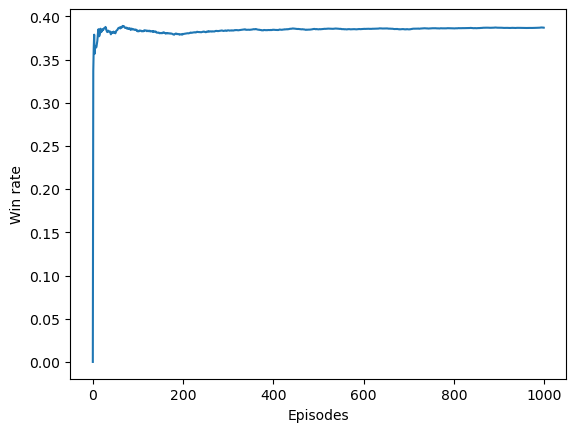

In [11]:
# Train the agent
sarsa_agent.train()

In [12]:
print(sarsa_agent.epsilon)
print(sarsa_agent.alpha)
print(env.observation_space)

0.1
0.1
Tuple(Discrete(18), Discrete(10))


In [13]:
# Test the agent
sarsa_agent.test()

Average Reward over 10 episodes: 40.0


In [14]:
print(f"table: {sarsa_agent.Q}")

table: {(10, 1): [0.49369099397884186, -1.0076582575133082], (10, 6): [2.0147820268653995, -0.05673960086814364], (13, 6): [0.5942860036489573, -1.2179901856602433], (10, 5): [1.952894550267325, 0.40186629188306505], (18, 5): [-1.7408000211019743, 5.648783086337279], (14, 6): [-1.3946056612500828, -1.3968810546659656], (10, 2): [0.3349433917156605, -0.10156258789906675], (14, 2): [0.40967748371409013, -1.5624167054864029], (4, 9): [0.15359807160240807, -1.2132747704416482], (8, 9): [1.6392864535123919, -0.23081283120111223], (14, 9): [-0.757564159558338, -1.2353914237000616], (17, 9): [-0.18846135383422707, -1.2030028489712692], (10, 7): [0.42094201063269965, -0.6278256986971046], (16, 7): [0.3028658685198504, 1.9849978222392823], (18, 7): [-0.967305933523865, 5.564506694014358], (18, 6): [-0.5155184479800624, 6.2182486884452], (12, 1): [-0.2504929567402234, -0.24934361639983968], (9, 8): [2.506131322142264, 1.542895515886841], (11, 8): [0.8647795026990983, -1.0074341706688257], (12, 8

## Training the model

This snippet is a simulation of the reinforcement learning agent playing Blackjack. 

The agent is using a custom environment called `BlackjackEnv` and an `Agent` class, both previously defined here. The agent is trained over a set number of episodes (30000), where it takes actions based on a Q-table and updates the Q-table based on the rewards received from each action. The simulation is run for 1000 rounds with 1000 samples to calculate the average payout per round. The agent's average payout is then plotted and printed, with the running average present for easier comprehension.

In [15]:
# Loading the custom model
env = BlackjackEnv()

agent = Agent(env, epsilon=1.0, alpha=0.01, gamma=0.01, num_episodes_to_train=30000)

num_rounds = 1000 # Payout calculated over num_rounds
num_samples = 1000 # num_rounds simulated over num_samples

average_payouts = []

observation = env.reset()
for sample in range(num_samples):
    round = 1
    total_payout = 0 # to store total payout over 'num_rounds'
    # Take action based on Q-table of the agent and learn based on that until 'num_episodes_to_train' = 0
    while round <= num_rounds:
        action = agent.choose_action(observation)
        next_observation, payout, is_done, _ = env.step(action)
        agent.learn(observation, action, payout, next_observation)
        total_payout += payout
        observation = next_observation
        if is_done:
            observation = env.reset() # Environment deals new cards to player and dealer
            round += 1
    average_payouts.append(total_payout)
    
avg_run = moving_average(average_payouts)

# Plot payout per 1000 episodes for episode
plt.figure(figsize=(10,6))
plt.plot(average_payouts, 'k-')
plt.plot(avg_run, 'r-')
plt.xlabel('Number of samples')
plt.ylabel('Payout after {} rounds'.format(num_rounds))
plt.grid(linestyle=':')
plt.show()      
    
print ("Average payout after {} rounds is: {}".format(num_rounds, sum(average_payouts)/(num_samples)))


TypeError: unhashable type: 'numpy.ndarray'